# 1. Web Scraping using Selenium, BeautifulSoup for Data

## 1.1 Import Library

In [70]:
import requests
from bs4 import BeautifulSoup
import time
import re
import pandas as pd
from selenium import webdriver
from selenium.webdriver import ActionChains
from selenium.webdriver.common.by import By
import numpy as np

import matplotlib.pyplot as plt
import seaborn as sns

## 1.2 kiko

### 1.2.1 lipsticks

In [3]:
driver = webdriver.Chrome() # Use driver = webdriver.Chrome(“Path to executable”) if Selenium is unable to identify the Chrome driver executable
url = "https://www.kikocosmetics.com/en-gb/c/make-up/lips/lipsticks/"
driver.get(url)
time.sleep(3)
driver.find_element(By.XPATH,'//*[@id="didomi-notice-agree-button"]').click()

# 設定每次滑動的步長以及間隔時間
scroll_pause_time = 0.1  # 每次小步驟之間等待的秒數
scroll_step = 100  # 每次滑動的像素

# 取得目前頁面的高度
current_height = driver.execute_script("return window.pageYOffset;")
total_height = driver.execute_script("return document.body.scrollHeight;")

while current_height < total_height:
    current_height += scroll_step
    driver.execute_script("window.scrollTo(0, arguments[0]);", current_height)
    time.sleep(scroll_pause_time)

soup = BeautifulSoup(driver.page_source, "html.parser")
print(soup.prettify())

list_of_lipsticks = soup.find_all("div", class_="product-grid_tile__NH1gg")
print(len(list_of_lipsticks))

<html dir="ltr" lang="en">
 <head>
  <script async="" src="https://static.criteo.net/js/ld/ld.js" type="text/javascript">
  </script>
  <meta charset="utf-8"/>
  <meta content="width=device-width" name="viewport"/>
  <title>
   Lipsticks: colours, shades, liquid or matte lipstick | KIKO
  </title>
  <meta content="Discover lip perfection! Browse KIKO’s wide range of coloured, liquid, and matte lipsticks for beautiful lips." name="description"/>
  <meta content="all" name="robots"/>
  <link href="https://www.kikocosmetics.com/en-gb/c/make-up/lips/lipsticks/" rel="canonical"/>
  <link href="https://www.kikocosmetics.com/ar-ae/c/make-up/lips/lipsticks/" hreflang="ar-ae" rel="alternate"/>
  <link href="https://www.kikocosmetics.com/de-at/c/make-up/lippen/lippenstifte/" hreflang="de-at" rel="alternate"/>
  <link href="https://www.kikocosmetics.com/de-ch/c/make-up/lippen/lippenstifte/" hreflang="de-ch" rel="alternate"/>
  <link href="https://www.kikocosmetics.com/de-de/c/make-up/lippen/lippe

In [4]:
lipsticks_data = {'names':[],'prices':[],'reviews':[],'reviews_rate':[]}
for lipsticks in list_of_lipsticks:
    lipsticks_data['names'].append(lipsticks.find('a',class_ = re.compile('product-tile_name__wMbjK')).text)
    lipsticks_data['prices'].append(lipsticks.find('div',class_ = re.compile('product-price_container__d7TLs')).text)
    
    review_number_div = lipsticks.find('div',class_ = re.compile('product-ratings_numberOfRatings__5fttX'))
    if review_number_div:
        lipsticks_data['reviews'].append(review_number_div.text)
    else:
        lipsticks_data['reviews'].append("")
    
    rating_div = lipsticks.find("div", class_=re.compile("product-ratings_container__HFeXF"))
    if rating_div:
        x = lipsticks.find('div',class_ = re.compile('product-tile_ratings__JC2FH'))
        lipsticks_data['reviews_rate'].append(x.find('div',class_ = re.compile('product-ratings_container__HFeXF')).get('aria-label').split(" ")[0])
    else:
        lipsticks_data['reviews_rate'].append("")


kiko_lipsticks_df = pd.DataFrame(lipsticks_data)
kiko_lipsticks_df["company"] = "kiko"
kiko_lipsticks_df

,names,prices,reviews,reviews_rate,company
0,Bridgerton Ballroom Beauty Satin Shine Lipstick,£20.99,(41),4.5,kiko
1,Create Your Balance Soft Touch Lip&Cheek,£12.99,(20),3.5,kiko
2,Disney - The Little Mermaid Creamy Lip Stylo,£16.99,(28),4.5,kiko
3,Dreamphoria Shapechanger Satin Lipstick,£15.99,,,kiko
4,Dreamphoria Tint Me Softly Lip Mousse,£14.99,,,kiko
5,Gloss Supreme Color Glaze Lip Lacquer,£13.99,(35),4.5,kiko
6,Gold Reflections Gleam & Care Lipstick Spf30,£15.99,(52),4.5,kiko
7,Golden Oasis Lips & Cheeks Tint,£15.99,,,kiko
8,Golden Oasis Unlimited Stylo Lipstick,£13.99,,,kiko
9,Gossamer Emotion Creamy Lipstick,£—,(595),4.75,kiko


### 1.2.2 Eyeshadows

In [5]:
driver = webdriver.Chrome() # Use driver = webdriver.Chrome(“Path to executable”) if Selenium is unable to identify the Chrome driver executable
url = "https://www.kikocosmetics.com/en-gb/c/make-up/eyes/eyeshadows/"
driver.get(url)

time.sleep(3)

driver.find_element(By.XPATH,'//*[@id="didomi-notice-agree-button"]').click()

# 設定每次滑動的步長以及間隔時間
scroll_pause_time = 0.1  # 每次小步驟之間等待的秒數
scroll_step = 100  # 每次滑動的像素

# 取得目前頁面的高度
current_height = driver.execute_script("return window.pageYOffset;")
total_height = driver.execute_script("return document.body.scrollHeight;")

while current_height < total_height:
    current_height += scroll_step
    driver.execute_script("window.scrollTo(0, arguments[0]);", current_height)
    time.sleep(scroll_pause_time)
    

soup = BeautifulSoup(driver.page_source, "html.parser")
print(soup.prettify())

list_of_eyeshadows = soup.find_all("div", class_="product-grid_tile__NH1gg")
print(len(list_of_eyeshadows))

<html dir="ltr" lang="en">
 <head>
  <meta charset="utf-8"/>
  <meta content="width=device-width" name="viewport"/>
  <title>
   Eyeshadow: palettes, creams, powder and sticks | KIKO
  </title>
  <meta content="Discover mesmerizing eyeshadows for captivating eyes. Explore KIKO's stunning range now!" name="description"/>
  <meta content="test" name="keywords"/>
  <meta content="all" name="robots"/>
  <link href="https://www.kikocosmetics.com/en-gb/c/make-up/eyes/eyeshadows/" rel="canonical"/>
  <link href="https://www.kikocosmetics.com/ar-ae/c/make-up/eyes/eyeshadows/" hreflang="ar-ae" rel="alternate"/>
  <link href="https://www.kikocosmetics.com/de-at/c/make-up/augen/lidschatten/" hreflang="de-at" rel="alternate"/>
  <link href="https://www.kikocosmetics.com/de-ch/c/make-up/augen/lidschatten/" hreflang="de-ch" rel="alternate"/>
  <link href="https://www.kikocosmetics.com/de-de/c/make-up/augen/lidschatten/" hreflang="de-de" rel="alternate"/>
  <link href="https://www.kikocosmetics.com/e

In [6]:
eyeshadows_data = {'names':[],'prices':[],'reviews':[],'reviews_rate':[]}
for eyeshadows in list_of_eyeshadows:
    eyeshadows_data['names'].append(eyeshadows.find('a',class_ = re.compile('product-tile_name__wMbjK')).text)
    eyeshadows_data['prices'].append(eyeshadows.find('div',class_ = re.compile('product-price_container__d7TLs')).text)
    
    review_number_div = eyeshadows.find('div',class_ = re.compile('product-ratings_numberOfRatings__5fttX'))
    if review_number_div:
        eyeshadows_data['reviews'].append(review_number_div.text)
    else:
        eyeshadows_data['reviews'].append("")
    
    rating_div = eyeshadows.find("div", class_=re.compile("product-ratings_container__HFeXF"))
    if rating_div:
        x = eyeshadows.find('div',class_ = re.compile('product-tile_ratings__JC2FH'))
        eyeshadows_data['reviews_rate'].append(x.find('div',class_ = re.compile('product-ratings_container__HFeXF')).get('aria-label').split(" ")[0])
    else:
        eyeshadows_data['reviews_rate'].append("")
    

kiko_eyeshadows_df = pd.DataFrame(eyeshadows_data)
kiko_eyeshadows_df["company"] = "kiko"
kiko_eyeshadows_df

,names,prices,reviews,reviews_rate,company
0,Bridgerton Gilded Glaze Shimmering Cream Eyesh...,£18.99,(41),4.5,kiko
1,Bright Duo Eyeshadow,£9.99,(52),4.25,kiko
2,Cool Colour Eyeshadow Stick,£10.99,(61),4,kiko
3,Days In Bloom Metamorphic Eyeshadow,£10.99,(11),4.75,kiko
4,Dreamphoria Forever Mate Duet Eyeshadow,£14.99,,,kiko
5,Glitter Shower Eyeshadow,£9.99,(291),4.75,kiko
6,Golden Oasis Radiant Eyeshadow,£13.99,,,kiko
7,Green Me Duo Eyeshadow,£10.99,(16),4.25,kiko
8,High Pigment Eyeshadow,£7.49,(289),4.75,kiko
9,Holiday Première Daring Duo Eyeshadow,£14.99,(52),4,kiko


### 1.2.3 Eyeliners

In [7]:
driver = webdriver.Chrome() # Use driver = webdriver.Chrome(“Path to executable”) if Selenium is unable to identify the Chrome driver executable
url = "https://www.kikocosmetics.com/en-gb/c/make-up/eyes/eyeliners/"
driver.get(url)

time.sleep(3)

driver.find_element(By.XPATH,'//*[@id="didomi-notice-agree-button"]').click()

# 設定每次滑動的步長以及間隔時間
scroll_pause_time = 0.1  # 每次小步驟之間等待的秒數
scroll_step = 100  # 每次滑動的像素

# 取得目前頁面的高度
current_height = driver.execute_script("return window.pageYOffset;")
total_height = driver.execute_script("return document.body.scrollHeight;")

while current_height < total_height:
    current_height += scroll_step
    driver.execute_script("window.scrollTo(0, arguments[0]);", current_height)
    time.sleep(scroll_pause_time)
    

soup = BeautifulSoup(driver.page_source, "html.parser")
print(soup.prettify())

list_of_eyeliners = soup.find_all("div", class_="product-grid_tile__NH1gg")
print(len(list_of_eyeliners))

<html dir="ltr" lang="en">
 <head>
  <meta charset="utf-8"/>
  <meta content="width=device-width" name="viewport"/>
  <title>
   Eyeliners: black and coloured, liquids and pens | KIKO
  </title>
  <meta content="Unleash your gaze's allure with KIKO eyeliners. Choose between a gel, liquid, pen or applicator eyeliner." name="description"/>
  <meta content="all" name="robots"/>
  <link href="https://www.kikocosmetics.com/en-gb/c/make-up/eyes/eyeliners/" rel="canonical"/>
  <link href="https://www.kikocosmetics.com/ar-ae/c/make-up/eyes/eyeliners/" hreflang="ar-ae" rel="alternate"/>
  <link href="https://www.kikocosmetics.com/de-at/c/make-up/augen/eyeliner/" hreflang="de-at" rel="alternate"/>
  <link href="https://www.kikocosmetics.com/de-ch/c/make-up/augen/eyeliner/" hreflang="de-ch" rel="alternate"/>
  <link href="https://www.kikocosmetics.com/de-de/c/make-up/augen/eyeliner/" hreflang="de-de" rel="alternate"/>
  <link href="https://www.kikocosmetics.com/en-ae/c/make-up/eyes/eyeliners/" hr

In [8]:
eyeliners_data = {'names':[],'prices':[],'reviews':[],'reviews_rate':[]}
for eyeliners in list_of_eyeliners:
    eyeliners_data['names'].append(eyeliners.find('a',class_ = re.compile('product-tile_name__wMbjK')).text)
    eyeliners_data['prices'].append(eyeliners.find('div',class_ = re.compile('product-price_container__d7TLs')).text)
    
    review_number_div = eyeliners.find('div',class_ = re.compile('product-ratings_numberOfRatings__5fttX'))
    if review_number_div:
        eyeliners_data['reviews'].append(review_number_div.text)
    else:
        eyeliners_data['reviews'].append("")
    
    rating_div = eyeliners.find("div", class_=re.compile("product-ratings_container__HFeXF"))
    if rating_div:
        x = eyeliners.find('div',class_ = re.compile('product-tile_ratings__JC2FH'))
        eyeliners_data['reviews_rate'].append(x.find('div',class_ = re.compile('product-ratings_container__HFeXF')).get('aria-label').split(" ")[0])
    else:
        eyeliners_data['reviews_rate'].append("")
    

kiko_eyeliners_df = pd.DataFrame(eyeliners_data)
kiko_eyeliners_df["company"] = "kiko"
kiko_eyeliners_df

,names,prices,reviews,reviews_rate,company
0,Daring Look Eye Marker,£11.49,(34),4.75,kiko
1,Definition Eyeliner,£10.49,,,kiko
2,Definition Waterproof Eyeliner,£10.49,(281),4.75,kiko
3,Glitter Eyeliner,£10.99,(28),4.5,kiko
4,Gold Reflections 10H Wear Graphic Eyeliner & K...,£11.49,(38),4.25,kiko
5,Gold Reflections 48H Wear Waterproof Eye Marker,£12.99,(40),4.5,kiko
6,Golden Oasis Precision Eyeliner Jet Black,£10.99,,,kiko
7,Holiday Wonderlights Twinkling Liquid Eyeliner,£13.99,(18),4.75,kiko
8,Intense Colour Long Lasting Eyeliner,£7.99,(528),4.75,kiko
9,Lasting Gel Eyeliner,£11.49,(4),4,kiko


### 1.2.4 Blush

In [9]:
driver = webdriver.Chrome() # Use driver = webdriver.Chrome(“Path to executable”) if Selenium is unable to identify the Chrome driver executable
url = "https://www.kikocosmetics.com/en-gb/c/make-up/face/blush/"
driver.get(url)

time.sleep(3)

driver.find_element(By.XPATH,'//*[@id="didomi-notice-agree-button"]').click()

# 設定每次滑動的步長以及間隔時間
scroll_pause_time = 0.1  # 每次小步驟之間等待的秒數
scroll_step = 100  # 每次滑動的像素

# 取得目前頁面的高度
current_height = driver.execute_script("return window.pageYOffset;")
total_height = driver.execute_script("return document.body.scrollHeight;")

while current_height < total_height:
    current_height += scroll_step
    driver.execute_script("window.scrollTo(0, arguments[0]);", current_height)
    time.sleep(scroll_pause_time)
    

soup = BeautifulSoup(driver.page_source, "html.parser")
print(soup.prettify())

list_of_blush = soup.find_all("div", class_="product-grid_tile__NH1gg")
print(len(list_of_blush))

<html dir="ltr" lang="en">
 <head>
  <meta charset="utf-8"/>
  <meta content="width=device-width" name="viewport"/>
  <title>
   Blusher: powder, cream and pearl blush | KIKO
  </title>
  <meta content="Get radiant skin with a KIKO cream, powder or compact blusher. Choose your favourite shades!" name="description"/>
  <meta content="all" name="robots"/>
  <link href="https://www.kikocosmetics.com/en-gb/c/make-up/face/blush/" rel="canonical"/>
  <link href="https://www.kikocosmetics.com/ar-ae/c/make-up/face/blush/" hreflang="ar-ae" rel="alternate"/>
  <link href="https://www.kikocosmetics.com/de-at/c/make-up/gesicht/blush/" hreflang="de-at" rel="alternate"/>
  <link href="https://www.kikocosmetics.com/de-ch/c/make-up/gesicht/blush/" hreflang="de-ch" rel="alternate"/>
  <link href="https://www.kikocosmetics.com/de-de/c/make-up/gesicht/blush/" hreflang="de-de" rel="alternate"/>
  <link href="https://www.kikocosmetics.com/en-ae/c/make-up/face/blush/" hreflang="en-ae" rel="alternate"/>
  <l

In [10]:
blush_data = {'names':[],'prices':[],'reviews':[],'reviews_rate':[]}
for blush in list_of_blush:
    blush_data['names'].append(blush.find('a',class_ = re.compile('product-tile_name__wMbjK')).text)
    blush_data['prices'].append(blush.find('div',class_ = re.compile('product-price_container__d7TLs')).text)
    
    review_number_div = blush.find('div',class_ = re.compile('product-ratings_numberOfRatings__5fttX'))
    if review_number_div:
        blush_data['reviews'].append(review_number_div.text)
    else:
        blush_data['reviews'].append("")
    
    rating_div = blush.find("div", class_=re.compile("product-ratings_container__HFeXF"))
    if rating_div:
        x = blush.find('div',class_ = re.compile('product-tile_ratings__JC2FH'))
        blush_data['reviews_rate'].append(x.find('div',class_ = re.compile('product-ratings_container__HFeXF')).get('aria-label').split(" ")[0])
    else:
        blush_data['reviews_rate'].append("")
    

kiko_blush_df = pd.DataFrame(blush_data)
kiko_blush_df["company"] = "kiko"
kiko_blush_df

,names,prices,reviews,reviews_rate,company
0,Bridgerton Bouquet Blush & Highlighter Duo,£25.99,(11),4,kiko
1,Dreamphoria All-In-Glow 3In1 Luminizer,£16.99,,,kiko
2,Dreamphoria Color Reveal Ph Blush,£14.99,,,kiko
3,Dreamphoria Heavenly Skin Blush,£18.99,,,kiko
4,Gloss Supreme Layering Matt&Glow Duo Blush,£18.99,(13),4.75,kiko
5,Golden Oasis Glow Cushion Blush,£16.99,(1),2,kiko
6,Green Me Blush,£12.49,(66),4,kiko
7,Smart Colour Blush,£7.99,(280),4.5,kiko
8,Street Heart Cheeky Flush Liquid Blush,£16.99,(2),5,kiko
9,Unlimited Blush,£11.49,(220),4.5,kiko


## 1.3 MAC

### 1.3.1 lipsticks

In [11]:
driver = webdriver.Chrome()
url = "https://www.maccosmetics.co.uk/products/13854/products/makeup/lips/lipstick"
driver.get(url)
time.sleep(3)
#Click the accept button for cookies
driver.find_element(By.XPATH,'//*[@id="onetrust-accept-btn-handler"]').click()
#Read a resulting HTML document using beautifulsoup
soup = BeautifulSoup(driver.page_source, "html.parser")
print(soup.prettify())

#Getting the list of lipsticks
list_of_lipsticks = soup.find_all("div", class_ = re.compile("product-brief product-brief-v2.*"))
print(len(list_of_lipsticks))

<html class="js js flexbox no-touch csstransforms csstransforms3d csstransitions audio svg json jquery-once-1-processed mq" data-useragent="Mozilla/5.0 (Macintosh; Intel Mac OS X 10_15_7) AppleWebKit/537.36 (KHTML, like Gecko) Chrome/133.0.0.0 Safari/537.36" dir="ltr" lang="en-GB" style="">
 <head>
  <script async="" src="https://connect.facebook.net/en_US/sdk.js?_=1740178265132">
  </script>
  <script async="" crossorigin="anonymous" src="https://connect.facebook.net/en_US/sdk.js?hash=b52ed8649a25454c39f997560d659219">
  </script>
  <meta content="IE=edge,chrome=1" http-equiv="X-UA-Compatible"/>
  <meta content="Lipstick: the iconic product that made MAC famous. Shade, define, and accentuate your lips with hundreds of hues in a finish that suits you. Shop lipsticks now." name="description"/>
  <meta content="mac lipstick, new lipstick, red lipstick, pink lipstick, nude lipstick, peach lipstick, new lipstick formula" property="keywords"/>
  <meta content="width=device-width, initial-sc

In [12]:
#Getting all the data(names,prices,reviews,reviews_rate) that we needed by using for loop
lipsticks_data = {'names':[],'prices':[],'reviews':[],'reviews_rate':[]}
for lipsticks in list_of_lipsticks:
    lipsticks_data['names'].append(lipsticks.find('a',class_ = re.compile('product-brief__name-link js-product__link-to-spp')).text)
    lipsticks_data['prices'].append(lipsticks.find('div',class_ = re.compile('product-price-v1 js-product-price-v1')).text)
    lipsticks_data['reviews'].append(lipsticks.find('div',class_ = re.compile('product-brief__rating-total js-product-brief__rating-total')).text)
    lipsticks_data['reviews_rate'].append(lipsticks.find('div',class_ = re.compile('product__rating-percentage js-product__rating-percentage')).get('style'))
mac_lipstick_df = pd.DataFrame(lipsticks_data)
mac_lipstick_df['company']='M.A.C'
mac_lipstick_df

,names,prices,reviews,reviews_rate,company
0,MACximal Silky Matte Lip Combo / Velvet Teddy,£38.00,,None,M.A.C
1,"Lustreglass Luminous Lip Combo / Thanks, It's ...",£38.00,,None,M.A.C
2,MACximal Silky Matte Lip Combo / Mehr,£38.00,,None,M.A.C
3,MACximal Sleek Satin Lip Combo / Crème In Your...,£38.00,,None,M.A.C
4,MACximal Silky Matte Lip Combo / Ruby Woo,£38.00,,None,M.A.C
5,MACximal Sleek Satin Lip Combo / Truth Be Untold,£38.00,,None,M.A.C
6,MACximal Silky Matte Lipstick / Luxe Luck,£25.00,,None,M.A.C
7,MACximal Sleek Satin Lipstick,£25.00,918,width: 92.8%;,M.A.C
8,Lustreglass Sheer-Shine Lipstick,£25.00,440,width: 94.6%;,M.A.C
9,MACXIMAL SILKY MATTE LIPSTICK,£25.00,1164,width: 93.4%;,M.A.C


### 1.3.2 Eyeshadows

In [13]:
driver = webdriver.Chrome()
url = "https://www.maccosmetics.co.uk/products/13840/products/makeup/eyes/eyeshadow"
driver.get(url)
time.sleep(3)
driver.find_element(By.XPATH,'//*[@id="onetrust-accept-btn-handler"]').click()

soup = BeautifulSoup(driver.page_source, "html.parser")
print(soup.prettify())

list_of_eyeshadow = soup.find_all("div", class_ = re.compile("product-brief product-brief-v2.*"))
print(len(list_of_eyeshadow))

<html class="js js flexbox no-touch csstransforms csstransforms3d csstransitions audio svg json jquery-once-1-processed mq" data-useragent="Mozilla/5.0 (Macintosh; Intel Mac OS X 10_15_7) AppleWebKit/537.36 (KHTML, like Gecko) Chrome/133.0.0.0 Safari/537.36" dir="ltr" lang="en-GB" style="">
 <head>
  <script async="" crossorigin="anonymous" src="https://connect.facebook.net/en_US/sdk.js?hash=b52ed8649a25454c39f997560d659219">
  </script>
  <meta content="IE=edge,chrome=1" http-equiv="X-UA-Compatible"/>
  <meta content="Shop our highly pigmented eyeshadows that apply evenly and blend perfectly: from glittery gold to bright and colourful tones, there’s a shade for every look." name="description"/>
  <meta content="eye shadow, eyeshadow, mac eyeshadow" property="keywords"/>
  <meta content="width=device-width, initial-scale=1.0, maximum-scale=1, user-scalable=no" name="viewport"/>
  <link href="https://www.maccosmetics.ae/ar-e-ae/products/13840/eyes/eyeshadow" hreflang="ar-ae" rel="altern

In [14]:
eyeshadow_data = {'names':[],'prices':[],'reviews':[],'reviews_rate':[]}
for eyeshadow in list_of_eyeshadow:
    eyeshadow_data['names'].append(eyeshadow.find('a',class_ = re.compile('product-brief__name-link js-product__link-to-spp')).text)
    eyeshadow_data['prices'].append(eyeshadow.find('div',class_ = re.compile('product-price-v1 js-product-price-v1')).text)
    eyeshadow_data['reviews'].append(eyeshadow.find('div',class_ = re.compile('product-brief__rating-total js-product-brief__rating-total')).text)
    eyeshadow_data['reviews_rate'].append(eyeshadow.find('div',class_ = re.compile('product__rating-percentage js-product__rating-percentage')).get('style'))
mac_eyeshadow_df = pd.DataFrame(eyeshadow_data)
mac_eyeshadow_df['company']='M.A.C'
mac_eyeshadow_df

,names,prices,reviews,reviews_rate,company
0,Dazzleshadow Liquid / Luxe Luck,£22.00,5,width: 100%;,M.A.C
1,Connect In Colour Eyeshadow Palette - Intimate...,£32.00,,None,M.A.C
2,Eyeshadow,£20.00,1007,width: 93.2%;,M.A.C
3,Dazzleshadow,£22.00,189,width: 92.8%;,M.A.C
4,Connect In Colour Eyeshadow Palette: Unfiltere...,£46.00,170,width: 95%;,M.A.C
5,Connect In Colour Eyeshadow Palette: Encrypted...,£32.00,83,width: 92.2%;,M.A.C
6,Connect In Colour Eyeshadow Palette: Embedded ...,£32.00,91,width: 95.6%;,M.A.C
7,Connect In Colour Eyeshadow Palette: Rose Lens,£32.00,375,width: 96.8%;,M.A.C
8,Dazzleshadow Liquid,£22.00,336,width: 89.8%;,M.A.C
9,Extra Dimension Eyeshadow,£22.00,94,width: 94%;,M.A.C


### 1.3.3 Eyeliners

In [15]:
#Open the website(eyelinear) by using the chrome
driver = webdriver.Chrome() # Use driver = webdriver.Chrome(“Path to executable”) if Selenium is unable to identify the Chrome driver executable
url = "https://www.maccosmetics.co.uk/products/13838/products/makeup/eyes/eyeliner"
driver.get(url)
time.sleep(3)
#Click the accept button for cookies
driver.find_element(By.XPATH,'//*[@id="onetrust-accept-btn-handler"]').click()
#Read a resulting HTML document using beautifulsoup
soup = BeautifulSoup(driver.page_source, "html.parser")
print(soup.prettify())

#Getting the list of eyelinears
list_of_eyeliners = soup.find_all("div", class_ = re.compile("product-brief product-brief-v2.*"))
print(len(list_of_eyeliners))

<html class="js js flexbox no-touch csstransforms csstransforms3d csstransitions audio svg json jquery-once-1-processed mq" data-useragent="Mozilla/5.0 (Macintosh; Intel Mac OS X 10_15_7) AppleWebKit/537.36 (KHTML, like Gecko) Chrome/133.0.0.0 Safari/537.36" dir="ltr" lang="en-GB" style="">
 <head>
  <script async="" crossorigin="anonymous" src="https://connect.facebook.net/en_US/sdk.js?hash=b52ed8649a25454c39f997560d659219">
  </script>
  <meta content="IE=edge,chrome=1" http-equiv="X-UA-Compatible"/>
  <meta content="Shop our range of eyeliners: from pencil to liquid eyeliner, all are long-lasting to take your look from day to night with ease. Free delivery on £20+ orders!" name="description"/>
  <meta content="" property="keywords"/>
  <meta content="width=device-width, initial-scale=1.0, maximum-scale=1, user-scalable=no" name="viewport"/>
  <link href="https://www.maccosmetics.ae/ar-e-ae/products/13838/eyes/eyeliner" hreflang="ar-ae" rel="alternate"/>
  <link href="https://www.mac

In [16]:
#Getting all the data(names,prices,reviews,reviews_rate) that we needed by using for loop
eyeliners_data = {'names':[],'prices':[],'reviews':[],'reviews_rate':[]}
for eyeliner in list_of_eyeliners:
    eyeliners_data['names'].append(eyeliner.find('a',class_ = re.compile('product-brief__name-link js-product__link-to-spp')).text)
    eyeliners_data['prices'].append(eyeliner.find('div',class_ = re.compile('product-price-v1 js-product-price-v1')).text)
    eyeliners_data['reviews'].append(eyeliner.find('div',class_ = re.compile('product-brief__rating-total js-product-brief__rating-total')).text)
    eyeliners_data['reviews_rate'].append(eyeliner.find('div',class_ = re.compile('product__rating-percentage js-product__rating-percentage')).get('style'))
mac_eyeliner_df = pd.DataFrame(eyeliners_data)
mac_eyeliner_df['company']='M.A.C'
mac_eyeliner_df

,names,prices,reviews,reviews_rate,company
0,Colour Excess Gel Pencil Eyeliner,£22.00,724,width: 89.4%;,M.A.C
1,Liquidlast 24-Hour Waterproof Eyeliner,£22.00,643,width: 87.4%;,M.A.C
2,Brushstroke 24-Hour Liner,£22.00,504,width: 84.4%;,M.A.C
3,Eye Kohl,£20.00,520,width: 86%;,M.A.C
4,Pro Longwear Fluidline Eyeliner And Brow Gel,£20.00,498,width: 85.8%;,M.A.C
5,Eye Pencil,£20.00,38,width: 75.8%;,M.A.C
6,Chromagraphic Pencil,£20.00,61,width: 78%;,M.A.C
7,Chromaline,£22.00,36,width: 84.4%;,M.A.C
8,Mixing Medium Eyeliner,£20.00,15,width: 96%;,M.A.C


### 1.3.4 Blush

In [35]:
#Open the website(blushers) by using the chrome
driver = webdriver.Chrome() # Use driver = webdriver.Chrome(“Path to executable”) if Selenium is unable to identify the Chrome driver executable
url = "https://www.maccosmetics.co.uk/products/13842/products/makeup/face/blusher"
driver.get(url)
time.sleep(3)
#Click the accept button for cookies
driver.find_element(By.XPATH,'//*[@id="onetrust-accept-btn-handler"]').click()
#Read a resulting HTML document using beautifulsoup
soup = BeautifulSoup(driver.page_source, "html.parser")
print(soup.prettify())

#Getting the list of blushers
list_of_blushers = soup.find_all("div", class_ = re.compile("product-brief product-brief-v2.*"))
print(len(list_of_blushers))

<html class="js js flexbox no-touch csstransforms csstransforms3d csstransitions audio svg json jquery-once-1-processed mq" data-useragent="Mozilla/5.0 (Macintosh; Intel Mac OS X 10_15_7) AppleWebKit/537.36 (KHTML, like Gecko) Chrome/133.0.0.0 Safari/537.36" dir="ltr" lang="en-GB" style="">
 <head>
  <script async="" crossorigin="anonymous" src="https://connect.facebook.net/en_US/sdk.js?hash=b52ed8649a25454c39f997560d659219">
  </script>
  <meta content="IE=edge,chrome=1" http-equiv="X-UA-Compatible"/>
  <meta content="We've got you covered with cream &amp; powder blushes in a variety of shades from pink, peach and brown-hued blushes. Shop MAC blushers for a healthy glow." name="description"/>
  <meta content="blusher, cream blush, best cream blush, mac cream blush, cream blush stick, best blushers, best cream blusher uk, shimmer blush, how to apply cream blush, powder blush, cream blush palette, peach cream blush, brown cream blush, cream blush for sensitive" property="keywords"/>
  <

In [40]:
#Getting all the data(names,prices,reviews,reviews_rate) that we needed by using for loop
blushers_data = {'names':[],'prices':[],'reviews':[],'reviews_rate':[]}
for blusher in list_of_blushers:
    blushers_data['names'].append(blusher.find('a',class_ = re.compile('product-brief__name-link js-product__link-to-spp')).text)
    blushers_data['prices'].append(blusher.find('div',class_ = re.compile('product-price-v1 js-product-price-v1')).text.split()[-1])
    blushers_data['reviews'].append(blusher.find('div',class_ = re.compile('product-brief__rating-total js-product-brief__rating-total')).text)
    blushers_data['reviews_rate'].append(blusher.find('div',class_ = re.compile('product__rating-percentage js-product__rating-percentage')).get('style'))
mac_blush_df = pd.DataFrame(blushers_data)
mac_blush_df['company']='M.A.C'
mac_blush_df

,names,prices,reviews,reviews_rate,company
0,Glow Play Cushiony Blush,£22.40,584,width: 93.4%;,M.A.C
1,Mineralize Blush,£22.40,212,width: 86.2%;,M.A.C
2,Extra Dimension Blush,£22.40,62,width: 93.2%;,M.A.C
3,Powder Blush,£22.40,584,width: 91.8%;,M.A.C
4,Sheertone Blush,£22.40,584,width: 91.8%;,M.A.C
5,Sheertone Shimmer Blush,£22.40,584,width: 91.8%;,M.A.C
6,Cream Colour Base,£26.00,111,width: 90%;,M.A.C
7,Pro Face Palette: Blush,£25.60,10,width: 100%;,M.A.C


## 1.4 Colourpop

### 1.4.1 lipsticks

In [19]:
driver = webdriver.Chrome()
url = "https://colourpop.com/collections/lips"
driver.get(url)
time.sleep(3)
driver.find_element(By.XPATH,'//*[@aria-label="allow cookies"]').click()
time.sleep(3)

while True:
    try:
        driver.find_element(By.XPATH,'//*[@class="btn mt-10"]').click()
        time.sleep(2) # wait 2 second
    except:
        break

soup = BeautifulSoup(driver.page_source, "html.parser")
print(soup.prettify())

list_of_lipsticks = soup.find_all("li", class_="w-full flex")
print(len(list_of_lipsticks))

<html class="js" lang="en" style="--announcement-bar-height: 34.1640625px; --header-height: 0px;">
 <head>
  <script async="" src="https://connect.facebook.net/signals/config/1654768898112506?v=2.9.184&amp;r=stable&amp;domain=colourpop.com&amp;hme=93c44828b638838a88daf3a14a90ff297f7fc4ade758f21de5500c9f17542765&amp;ex_m=70%2C122%2C107%2C111%2C61%2C4%2C100%2C69%2C16%2C97%2C89%2C51%2C54%2C173%2C176%2C188%2C184%2C185%2C187%2C29%2C101%2C53%2C77%2C186%2C168%2C171%2C181%2C182%2C189%2C132%2C41%2C194%2C191%2C192%2C34%2C144%2C15%2C50%2C198%2C197%2C134%2C18%2C40%2C1%2C43%2C65%2C66%2C67%2C71%2C93%2C17%2C14%2C96%2C92%2C91%2C108%2C52%2C110%2C39%2C109%2C30%2C94%2C26%2C169%2C172%2C141%2C86%2C56%2C84%2C33%2C73%2C0%2C95%2C32%2C28%2C82%2C83%2C88%2C47%2C46%2C87%2C37%2C11%2C12%2C13%2C6%2C7%2C25%2C22%2C23%2C57%2C62%2C64%2C75%2C102%2C27%2C76%2C9%2C8%2C80%2C48%2C21%2C104%2C103%2C105%2C98%2C10%2C20%2C3%2C38%2C74%2C19%2C5%2C90%2C81%2C44%2C35%2C85%2C2%2C36%2C63%2C42%2C106%2C45%2C79%2C68%2C112%2C60%2C59%2C31%2C9

In [20]:
#Getting all the data(names,prices,reviews,reviews_rate) that we needed by using for loop
lipsticks_data = {'names':[],'prices':[],'reviews_rate':[],'reviews':[]}
for lipsticks in list_of_lipsticks:
    lipsticks_name = lipsticks.find('a',class_ = re.compile('line-clamp-2 text-center'))
    if lipsticks_name:
        lipsticks_data['names'].append(lipsticks_name.text)
    else:
        lipsticks_data['names'].append("")
    
    price_tag = lipsticks.find('span',class_ = re.compile('font-bold font-bold'))
    if price_tag:
        lipsticks_data['prices'].append(price_tag.text)
    else:
        lipsticks_data['prices'].append("")
    
    rate = lipsticks.find('div',class_ = re.compile('yotpo-sr-bottom-line-summary'))
    if rate:
        lipsticks_data['reviews_rate'].append(rate.text)
    else:
        lipsticks_data['reviews_rate'].append("")
    
    review_number = lipsticks.find('div',class_ = re.compile('yotpo-sr-bottom-line-text yotpo-sr-bottom-line-text--right-panel'))
    if review_number:
        lipsticks_data['reviews'].append(review_number.text)
    else:
        lipsticks_data['reviews'].append("")
    
    
colourpop_lipsticks_df = pd.DataFrame(lipsticks_data)
colourpop_lipsticks_df['company']='colourpop'
colourpop_lipsticks_df

,names,prices,reviews_rate,reviews,company
0,\n \n Lippie Pencil\n ...,\n $7.00\n,\n\n5 out of 5 star rating\n\n\n\n\n\n\n\n\n\n...,\n 23 Reviews\n,colourpop
1,\n \n Power Pout Lipstick\...,\n $10.00\n,\n\n4.8 out of 5 star rating\n\n\n\n\n\n\n\n\n...,\n 12 Reviews\n,colourpop
2,\n \n Fresh Kiss Glossy Ba...,\n $10.00\n,\n\n4.9 out of 5 star rating\n\n\n\n\n\n\n\n\n...,\n 132 Reviews\n,colourpop
3,\n \n Ultra Matte Lip\n ...,\n $9.00\n,\n\n4.9 out of 5 star rating\n\n\n\n\n\n\n\n\n...,\n 55 Reviews\n,colourpop
4,\n \n Fresh Kiss Glossy Li...,\n $9.00\n,\n\n4.8 out of 5 star rating\n\n\n\n\n\n\n\n\n...,\n 240 Reviews\n,colourpop
...,...,...,...,...,...
131,\n \n Magix Pout\n ...,\n $54.00\n,,,colourpop
132,\n \n Evolution\n ...,\n $27.00\n,,,colourpop
133,\n \n True Love's Kiss\n ...,\n $50.00\n,,,colourpop
134,\n \n Pack Member\n ...,,,,colourpop


### 1.4.2 Eyeshadows

In [21]:
driver = webdriver.Chrome()
url = "https://colourpop.com/collections/eyeshadow"
driver.get(url)
time.sleep(3)
driver.find_element(By.XPATH,'//*[@aria-label="allow cookies"]').click()
time.sleep(3)

while True:
    try:
        driver.find_element(By.XPATH,'//*[@class="btn mt-10"]').click()
        time.sleep(2) # wait 2 second
    except:
        break

soup = BeautifulSoup(driver.page_source, "html.parser")
print(soup.prettify())

list_of_eyeshadows = soup.find_all("li", class_="w-full flex")
print(len(list_of_eyeshadows))

<html class="js" lang="en" style="--announcement-bar-height: 34.1640625px; --header-height: 0px;">
 <head>
  <script async="" src="https://connect.facebook.net/signals/config/1654768898112506?v=2.9.184&amp;r=stable&amp;domain=colourpop.com&amp;hme=93c44828b638838a88daf3a14a90ff297f7fc4ade758f21de5500c9f17542765&amp;ex_m=70%2C122%2C107%2C111%2C61%2C4%2C100%2C69%2C16%2C97%2C89%2C51%2C54%2C173%2C176%2C188%2C184%2C185%2C187%2C29%2C101%2C53%2C77%2C186%2C168%2C171%2C181%2C182%2C189%2C132%2C41%2C194%2C191%2C192%2C34%2C144%2C15%2C50%2C198%2C197%2C134%2C18%2C40%2C1%2C43%2C65%2C66%2C67%2C71%2C93%2C17%2C14%2C96%2C92%2C91%2C108%2C52%2C110%2C39%2C109%2C30%2C94%2C26%2C169%2C172%2C141%2C86%2C56%2C84%2C33%2C73%2C0%2C95%2C32%2C28%2C82%2C83%2C88%2C47%2C46%2C87%2C37%2C11%2C12%2C13%2C6%2C7%2C25%2C22%2C23%2C57%2C62%2C64%2C75%2C102%2C27%2C76%2C9%2C8%2C80%2C48%2C21%2C104%2C103%2C105%2C98%2C10%2C20%2C3%2C38%2C74%2C19%2C5%2C90%2C81%2C44%2C35%2C85%2C2%2C36%2C63%2C42%2C106%2C45%2C79%2C68%2C112%2C60%2C59%2C31%2C9

In [22]:
#Getting all the data(names,prices,reviews,reviews_rate) that we needed by using for loop
eyeshadows_data = {'names':[],'prices':[],'reviews_rate':[],'reviews':[]}
for eyeshadows in list_of_eyeshadows:
    eyeshadows_name = eyeshadows.find('a',class_ = re.compile('line-clamp-2 text-center'))
    if eyeshadows_name:
        eyeshadows_data['names'].append(eyeshadows_name.text)
    else:
        eyeshadows_data['names'].append("")
    
    price_tag = eyeshadows.find('span',class_ = re.compile('font-bold font-bold'))
    if price_tag:
        eyeshadows_data['prices'].append(price_tag.text)
    else:
        eyeshadows_data['prices'].append("")
    
    rate = eyeshadows.find('div',class_ = re.compile('yotpo-sr-bottom-line-summary'))
    if rate:
        eyeshadows_data['reviews_rate'].append(rate.text)
    else:
        eyeshadows_data['reviews_rate'].append("")
    
    review_number = eyeshadows.find('div',class_ = re.compile('yotpo-sr-bottom-line-text yotpo-sr-bottom-line-text--right-panel'))
    if review_number:
        eyeshadows_data['reviews'].append(review_number.text)
    else:
        eyeshadows_data['reviews'].append("")

colourpop_eyeshadow_df = pd.DataFrame(eyeshadows_data)
colourpop_eyeshadow_df['company']='colourpop'
colourpop_eyeshadow_df

,names,prices,reviews_rate,reviews,company
0,\n \n Super Shock Shadow\n...,\n $7.00\n,\n\n4.9 out of 5 star rating\n\n\n\n\n\n\n\n\n...,\n 416 Reviews\n,colourpop
1,\n \n Shadow Stix\n ...,\n $5.00\n,\n\n5 out of 5 star rating\n\n\n\n\n\n\n\n\n\n...,\n 71 Reviews\n,colourpop
2,\n \n Chrome Liquid Eyesha...,\n $12.00\n,\n\n4.9 out of 5 star rating\n\n\n\n\n\n\n\n\n...,\n 84 Reviews\n,colourpop
3,\n \n Jelly Much Shadow\n ...,\n $9.00\n,\n\n4.9 out of 5 star rating\n\n\n\n\n\n\n\n\n...,\n 1885 Reviews\n,colourpop
4,\n \n Pressed Powder Shado...,\n $5.00\n,\n\n4.9 out of 5 star rating\n\n\n\n\n\n\n\n\n...,\n 180 Reviews\n,colourpop
5,\n \n Love Triangle\n ...,\n $32.00\n,\n\n5 out of 5 star rating\n\n\n\n\n\n\n\n\n\n...,\n 29 Reviews\n,colourpop
6,\n \n New Moon Multichrome...,\n $12.00\n,\n\n4.9 out of 5 star rating\n\n\n\n\n\n\n\n\n...,\n 16 Reviews\n,colourpop
7,\n \n New Moon Multichrome...,\n $12.00\n,\n\n4.9 out of 5 star rating\n\n\n\n\n\n\n\n\n...,\n 13 Reviews\n,colourpop
8,\n \n New Moon Multichrome...,\n $12.00\n,\n\n4.8 out of 5 star rating\n\n\n\n\n\n\n\n\n...,\n 16 Reviews\n,colourpop
9,\n \n Bloodsuckers\n ...,\n $15.00\n,\n\n4.9 out of 5 star rating\n\n\n\n\n\n\n\n\n...,\n 18 Reviews\n,colourpop


### 1.4.3 Eyeliners

In [23]:
driver = webdriver.Chrome()
url = "https://colourpop.com/collections/eyeliner"
driver.get(url)
time.sleep(3)
driver.find_element(By.XPATH,'//*[@aria-label="allow cookies"]').click()

soup = BeautifulSoup(driver.page_source, "html.parser")
print(soup.prettify())

list_of_eyeliner = soup.find_all("li", class_="w-full flex")
print(len(list_of_eyeliner))

<html class="js" lang="en" style="--announcement-bar-height: 34.1640625px; --header-height: 164.328125px;">
 <head>
  <script async="" src="https://cdn.refersion.com/pixel.js?shop=colourpop-prd.myshopify.com&amp;client_id=16985&amp;pk=pub_d9fedc51d5c5260e5546&amp;shop=colourpop-prd.myshopify.com" type="text/javascript">
  </script>
  <script async="" src="https://a.glosku.com/shopify-client/glosku-bundle.js?shop=colourpop-prd.myshopify.com" type="text/javascript">
  </script>
  <script async="" src="https://cdn-app.cart-bot.net/public/js/append.js?shop=colourpop-prd.myshopify.com" type="text/javascript">
  </script>
  <script async="" src="https://geolocation-recommendations.shopifyapps.com/selectors/script.js?shop=colourpop-prd.myshopify.com" type="text/javascript">
  </script>
  <script async="" src="https://geolocation-recommendations.shopifyapps.com/locale_bar/script.js?shop=colourpop-prd.myshopify.com" type="text/javascript">
  </script>
  <script async="" src="https://js.klevu.co

In [24]:
#Getting all the data(names,prices,reviews,reviews_rate) that we needed by using for loop
eyeliner_data = {'names':[],'prices':[],'reviews_rate':[],'reviews':[]}
for eyeliner in list_of_eyeliner:
    eyeliner_name = eyeliner.find('a',class_ = re.compile('line-clamp-2 text-center'))
    if eyeliner_name:
        eyeliner_data['names'].append(eyeliner_name.text)
    else:
        eyeliner_data['names'].append("")
    
    price_tag = eyeliner.find('span',class_ = re.compile('font-bold font-bold'))
    if price_tag:
        eyeliner_data['prices'].append(price_tag.text)
    else:
        eyeliner_data['prices'].append("")
    
    rate = eyeliner.find('div',class_ = re.compile('yotpo-sr-bottom-line-summary'))
    if rate:
        eyeliner_data['reviews_rate'].append(rate.text)
    else:
        eyeliner_data['reviews_rate'].append("")
    
    review_number = eyeliner.find('div',class_ = re.compile('yotpo-sr-bottom-line-text yotpo-sr-bottom-line-text--right-panel'))
    if review_number:
        eyeliner_data['reviews'].append(review_number.text)
    else:
        eyeliner_data['reviews'].append("")
    
    
colourpop_eyeliner_df = pd.DataFrame(eyeliner_data)
colourpop_eyeliner_df['company']='colourpop'
colourpop_eyeliner_df

,names,prices,reviews_rate,reviews,company
0,\n \n Chrome Creme Gel Lin...,\n $9.00\n,\n\n4.9 out of 5 star rating\n\n\n\n\n\n\n\n\n...,\n 188 Reviews\n,colourpop
1,\n \n Creme Gel Liner\n ...,\n $8.00\n,\n\n4.9 out of 5 star rating\n\n\n\n\n\n\n\n\n...,\n 190 Reviews\n,colourpop
2,\n \n BFF Liquid Liner\n ...,\n $9.00\n,\n\n4.9 out of 5 star rating\n\n\n\n\n\n\n\n\n...,\n 563 Reviews\n,colourpop
3,\n \n Good Shift\n ...,\n $20.00\n,\n\n0 out of 5 star rating\n\n\n\n\n\n\n\n\n\n...,\n 0 Reviews\n,colourpop
4,\n \n Bratz BFF Liquid Lin...,\n $10.00\n,\n\n4.6 out of 5 star rating\n\n\n\n\n\n\n\n\n...,\n 11 Reviews\n,colourpop
5,\n \n Twilight Graphix Ink...,\n $10.00\n,\n\n4.9 out of 5 star rating\n\n\n\n\n\n\n\n\n...,\n 63 Reviews\n,colourpop
6,\n \n Harry Potter Graphix...,\n $6.00\n,\n\n4.9 out of 5 star rating\n\n\n\n\n\n\n\n\n...,\n 62 Reviews\n,colourpop
7,\n \n Mariale Graphix Ink ...,\n $4.00\n,\n\n4.9 out of 5 star rating\n\n\n\n\n\n\n\n\n...,\n 34 Reviews\n,colourpop
8,\n \n Graphix Ink Liner\n ...,\n $5.00\n,\n\n4.8 out of 5 star rating\n\n\n\n\n\n\n\n\n...,\n 42 Reviews\n,colourpop
9,\n \n The Total Package\n ...,\n $99.00\n,\n\n4.8 out of 5 star rating\n\n\n\n\n\n\n\n\n...,\n 26 Reviews\n,colourpop


### 1.4.4 Blush

In [25]:
driver = webdriver.Chrome()
url = "https://colourpop.com/collections/blush"
driver.get(url)
time.sleep(3)
driver.find_element(By.XPATH,'//*[@aria-label="allow cookies"]').click()

soup = BeautifulSoup(driver.page_source, "html.parser")
print(soup.prettify())

list_of_blushs = soup.find_all("li", class_="w-full flex")
print(len(list_of_blushs))

<html class="js" lang="en" style="--announcement-bar-height: 34.1640625px; --header-height: 164.328125px;">
 <head>
  <script async="" class="optanon-category-C0004-C0005" src="https://sc-static.net/scevent.min.js" type="text/plain">
  </script>
  <script async="" src="https://www.googletagmanager.com/gtag/js?id=G-WSYJCRME4P&amp;l=dataLayer&amp;cx=c&amp;gtm=45He52k0v9182596889za200" type="text/javascript">
  </script>
  <script async="" src="https://cdn.refersion.com/pixel.js?shop=colourpop-prd.myshopify.com&amp;client_id=16985&amp;pk=pub_d9fedc51d5c5260e5546&amp;shop=colourpop-prd.myshopify.com" type="text/javascript">
  </script>
  <script async="" src="https://a.glosku.com/shopify-client/glosku-bundle.js?shop=colourpop-prd.myshopify.com" type="text/javascript">
  </script>
  <script async="" src="https://cdn-app.cart-bot.net/public/js/append.js?shop=colourpop-prd.myshopify.com" type="text/javascript">
  </script>
  <script async="" src="https://geolocation-recommendations.shopifyapp

In [26]:
#Getting all the data(names,prices,reviews,reviews_rate) that we needed by using for loop
blushs_data = {'names':[],'prices':[],'reviews_rate':[],'reviews':[]}
for blushs in list_of_blushs:
    blushs_name = blushs.find('a',class_ = re.compile('line-clamp-2 text-center'))
    if blushs_name:
        blushs_data['names'].append(blushs_name.text)
    else:
        blushs_data['names'].append("")
    
    price_tag = blushs.find('span',class_ = re.compile('font-bold font-bold'))
    if price_tag:
        blushs_data['prices'].append(price_tag.text)
    else:
        blushs_data['prices'].append("")
    
    rate = blushs.find('div',class_ = re.compile('yotpo-sr-bottom-line-summary'))
    if rate:
        blushs_data['reviews_rate'].append(rate.text)
    else:
        blushs_data['reviews_rate'].append("")
    
    review_number = blushs.find('div',class_ = re.compile('yotpo-sr-bottom-line-text yotpo-sr-bottom-line-text--right-panel'))
    if review_number:
        blushs_data['reviews'].append(review_number.text)
    else:
        blushs_data['reviews'].append("")
    
colourpop_blushs_df = pd.DataFrame(blushs_data)
colourpop_blushs_df['company']='colourpop'
colourpop_blushs_df

,names,prices,reviews_rate,reviews,company
0,\n \n Totally Lovestruck\n...,\n $32.00\n,\n\n0 out of 5 star rating\n\n\n\n\n\n\n\n\n\n...,\n 0 Reviews\n,colourpop
1,\n \n Cupid Called\n ...,\n $32.00\n,\n\n0 out of 5 star rating\n\n\n\n\n\n\n\n\n\n...,\n 0 Reviews\n,colourpop
2,\n \n Heart to Heart\n ...,\n $32.00\n,\n\n0 out of 5 star rating\n\n\n\n\n\n\n\n\n\n...,\n 0 Reviews\n,colourpop
3,\n \n Current Crush\n ...,\n $32.00\n,\n\n0 out of 5 star rating\n\n\n\n\n\n\n\n\n\n...,\n 0 Reviews\n,colourpop
4,\n \n Liquid Blush\n ...,\n $10.00\n,\n\n4.9 out of 5 star rating\n\n\n\n\n\n\n\n\n...,\n 37 Reviews\n,colourpop
5,\n \n Instant Crush Lip & ...,\n $10.00\n,\n\n5 out of 5 star rating\n\n\n\n\n\n\n\n\n\n...,\n 6 Reviews\n,colourpop
6,\n \n Heart Blush\n ...,\n $12.00\n,\n\n4.9 out of 5 star rating\n\n\n\n\n\n\n\n\n...,\n 301 Reviews\n,colourpop
7,\n \n Super Shock Blush\n ...,\n $4.50\n,\n\n4.8 out of 5 star rating\n\n\n\n\n\n\n\n\n...,\n 87 Reviews\n,colourpop
8,\n \n Instant Crush Lip & ...,\n $10.00\n,\n\n5 out of 5 star rating\n\n\n\n\n\n\n\n\n\n...,\n 4 Reviews\n,colourpop
9,\n \n Instant Crush Lip & ...,\n $10.00\n,\n\n5 out of 5 star rating\n\n\n\n\n\n\n\n\n\n...,\n 6 Reviews\n,colourpop


# 2. Data processing

In [ ]:
# dataframe list
# save data
kiko_lipsticks_df.to_csv('/Users/adam/Desktop/Bayes/Class/Term2/Digital_Technologies_and_Value_Creation/Homework/raw_data/kiko_lipsticks_df.csv', index=False, encoding='utf-8')
kiko_blush_df.to_csv('/Users/adam/Desktop/Bayes/Class/Term2/Digital_Technologies_and_Value_Creation/Homework/raw_data/kiko_blush_df.csv', index=False, encoding='utf-8')
kiko_eyeliners_df.to_csv('/Users/adam/Desktop/Bayes/Class/Term2/Digital_Technologies_and_Value_Creation/Homework/raw_data/kiko_eyeliners_df.csv', index=False, encoding='utf-8')
kiko_eyeshadows_df.to_csv('/Users/adam/Desktop/Bayes/Class/Term2/Digital_Technologies_and_Value_Creation/Homework/raw_data/kiko_eyeshadows_df.csv', index=False, encoding='utf-8')
mac_lipstick_df.to_csv('/Users/adam/Desktop/Bayes/Class/Term2/Digital_Technologies_and_Value_Creation/Homework/raw_data/mac_lipstick_df.csv', index=False, encoding='utf-8')
mac_blush_df.to_csv('/Users/adam/Desktop/Bayes/Class/Term2/Digital_Technologies_and_Value_Creation/Homework/raw_data/mac_blush_df.csv', index=False, encoding='utf-8')
mac_eyeliner_df.to_csv('/Users/adam/Desktop/Bayes/Class/Term2/Digital_Technologies_and_Value_Creation/Homework/raw_data/mac_eyeliner_df.csv', index=False, encoding='utf-8')
mac_eyeshadow_df.to_csv('/Users/adam/Desktop/Bayes/Class/Term2/Digital_Technologies_and_Value_Creation/Homework/raw_data/mac_eyeshadow_df.csv', index=False, encoding='utf-8')
colourpop_lipsticks_df.to_csv('/Users/adam/Desktop/Bayes/Class/Term2/Digital_Technologies_and_Value_Creation/Homework/raw_data/colourpop_lipsticks_df.csv', index=False, encoding='utf-8')
colourpop_blushs_df.to_csv('/Users/adam/Desktop/Bayes/Class/Term2/Digital_Technologies_and_Value_Creation/Homework/raw_data/colourpop_blushs_df.csv', index=False, encoding='utf-8')
colourpop_eyeliner_df.to_csv('/Users/adam/Desktop/Bayes/Class/Term2/Digital_Technologies_and_Value_Creation/Homework/raw_data/colourpop_eyeliner_df.csv', index=False, encoding='utf-8')
colourpop_eyeshadow_df.to_csv('/Users/adam/Desktop/Bayes/Class/Term2/Digital_Technologies_and_Value_Creation/Homework/raw_data/colourpop_eyeshadow_df.csv', index=False, encoding='utf-8')

## 2.1 Merge data

In [56]:
lipsticks_df_merged = pd.concat([kiko_lipsticks_df, mac_lipstick_df, colourpop_lipsticks_df], ignore_index=True)
eyeshadow_df_merged = pd.concat([kiko_eyeshadows_df, mac_eyeshadow_df, colourpop_eyeshadow_df], ignore_index=True)
eyeliner_df_merged = pd.concat([kiko_eyeliners_df, mac_eyeliner_df, colourpop_eyeliner_df], ignore_index=True)
blush_df_merged = pd.concat([kiko_blush_df, mac_blush_df, colourpop_blushs_df], ignore_index=True)

## 2.2 Clean data and save data

In [ ]:
def data_cleanning(dataframe):
    dataframe['names'] = (
        dataframe['names']
        .str.replace('\n', '', regex=False)
        .str.strip()
        .astype(str)
    )
    dataframe['prices'] = (
        dataframe['prices']
        .str.replace('\n', '', regex=False)
        .str.replace('£', '', regex=False)
        .str.replace('—', '', regex=False)
        .str.replace('$', '', regex=False)
        .str.strip()
        .replace('', np.nan)
        .astype(float)
    )
    dataframe['reviews'] = (
        dataframe['reviews']
        .str.replace('\n', '', regex=False)
        .str.replace('Reviews', '', regex=False)
        .str.replace('(', '', regex=False)
        .str.replace(')', '', regex=False)
        .str.strip()
        .replace('', '0')
        .astype(float)
    )
    # 針對 reviews_rate 欄位：
    # 1. 利用正規表達式提取數字部分（含小數點）
    # 2. 轉換為 float
    dataframe['reviews_rate'] = (
        dataframe['reviews_rate'] 
        .str.extract(r'(\d+\.?\d*)')[0]  # 提取第一個符合條件的子字串
        .replace('0', np.nan)
        .astype(float)
    )
    dataframe.loc[dataframe['reviews_rate'] <= 5, 'reviews_rate'] *= 20
    
    # Define the condition for rows to drop // prices = NaN & reviews_rate = NaN & reviews = 0
    condition = (dataframe['prices'].isna()) & (dataframe['reviews_rate'].isna()) & (dataframe['reviews'] == 0)
    # Filter out those rows (i.e., keep rows that do NOT meet the condition)
    dataframe = dataframe[~condition]
    
    result = dataframe
    
    return result

In [58]:
lipsticks_df_merged = data_cleanning(lipsticks_df_merged)
eyeshadow_df_merged = data_cleanning(eyeshadow_df_merged)
eyeliner_df_merged = data_cleanning(eyeliner_df_merged)
blush_df_merged = data_cleanning(blush_df_merged)

In [ ]:
# save data
lipsticks_df_merged.to_csv('lipsticks_df_merged.csv', index=False, encoding='utf-8')
eyeshadow_df_merged.to_csv('eyeshadow_df_merged.csv', index=False, encoding='utf-8')
eyeliner_df_merged.to_csv('eyeliner_df_merged.csv', index=False, encoding='utf-8')
blush_df_merged.to_csv('blush_df_merged.csv', index=False, encoding='utf-8')

In [ ]:
lipsticks_df_merged

,names,prices,reviews,reviews_rate,company
0,Bridgerton Ballroom Beauty Satin Shine Lipstick,20.99,41.0,90.0,kiko
1,Create Your Balance Soft Touch Lip&Cheek,12.99,20.0,70.0,kiko
2,Disney - The Little Mermaid Creamy Lip Stylo,16.99,28.0,90.0,kiko
3,Dreamphoria Shapechanger Satin Lipstick,15.99,0.0,NaN,kiko
4,Dreamphoria Tint Me Softly Lip Mousse,14.99,0.0,NaN,kiko
...,...,...,...,...,...
187,Magix Pout,54.00,0.0,NaN,colourpop
188,Evolution,27.00,0.0,NaN,colourpop
189,True Love's Kiss,50.00,0.0,NaN,colourpop
190,Pack Member,NaN,0.0,NaN,colourpop


In [60]:
eyeshadow_df_merged

,names,prices,reviews,reviews_rate,company
0,Bridgerton Gilded Glaze Shimmering Cream Eyesh...,18.99,41.0,90.0,kiko
1,Bright Duo Eyeshadow,9.99,52.0,85.0,kiko
2,Cool Colour Eyeshadow Stick,10.99,61.0,80.0,kiko
3,Days In Bloom Metamorphic Eyeshadow,10.99,11.0,95.0,kiko
4,Dreamphoria Forever Mate Duet Eyeshadow,14.99,0.0,NaN,kiko
...,...,...,...,...,...
66,Vibe Shift,34.00,0.0,NaN,colourpop
67,Drama Queen,34.00,0.0,NaN,colourpop
68,Totally Jelly,115.00,0.0,NaN,colourpop
69,Eerie Estate,32.00,0.0,NaN,colourpop


In [61]:
eyeliner_df_merged

,names,prices,reviews,reviews_rate,company
0,Daring Look Eye Marker,11.49,34.0,95.0,kiko
1,Definition Eyeliner,10.49,0.0,NaN,kiko
2,Definition Waterproof Eyeliner,10.49,281.0,95.0,kiko
3,Glitter Eyeliner,10.99,28.0,90.0,kiko
4,Gold Reflections 10H Wear Graphic Eyeliner & K...,11.49,38.0,85.0,kiko
5,Gold Reflections 48H Wear Waterproof Eye Marker,12.99,40.0,90.0,kiko
6,Golden Oasis Precision Eyeliner Jet Black,10.99,0.0,NaN,kiko
7,Holiday Wonderlights Twinkling Liquid Eyeliner,13.99,18.0,95.0,kiko
8,Intense Colour Long Lasting Eyeliner,7.99,528.0,95.0,kiko
9,Lasting Gel Eyeliner,11.49,4.0,80.0,kiko


In [62]:
blush_df_merged

,names,prices,reviews,reviews_rate,company
0,Bridgerton Bouquet Blush & Highlighter Duo,25.99,11.0,80.0,kiko
1,Dreamphoria All-In-Glow 3In1 Luminizer,16.99,0.0,NaN,kiko
2,Dreamphoria Color Reveal Ph Blush,14.99,0.0,NaN,kiko
3,Dreamphoria Heavenly Skin Blush,18.99,0.0,NaN,kiko
4,Gloss Supreme Layering Matt&Glow Duo Blush,18.99,13.0,95.0,kiko
5,Golden Oasis Glow Cushion Blush,16.99,1.0,40.0,kiko
6,Green Me Blush,12.49,66.0,80.0,kiko
7,Smart Colour Blush,7.99,280.0,90.0,kiko
8,Street Heart Cheeky Flush Liquid Blush,16.99,2.0,100.0,kiko
9,Unlimited Blush,11.49,220.0,90.0,kiko


## 2.3 Read data

In [111]:
lipsticks_df_merged = pd.read_csv('lipsticks_df_merged.csv')
eyeshadow_df_merged = pd.read_csv('eyeshadow_df_merged.csv')
eyeliner_df_merged = pd.read_csv('eyeliner_df_merged.csv')
blush_df_merged = pd.read_csv('blush_df_merged.csv')

all_data = pd.concat([lipsticks_df_merged, eyeshadow_df_merged, eyeliner_df_merged, blush_df_merged], ignore_index=True)


# 3. Analysing Data and Plot Visualising

## 3.1 All data

#### statistic

In [127]:
all_data.describe()

,prices,reviews,reviews_rate
count,320.000000,325.000000,180.000000
mean,19.580031,110.935385,92.000000
std,13.881751,248.944523,7.228497
min,4.000000,0.000000,40.000000
25%,10.000000,0.000000,89.950000
50%,15.990000,11.000000,94.000000
75%,25.000000,83.000000,97.100000
max,115.000000,2002.000000,100.000000


#### plot

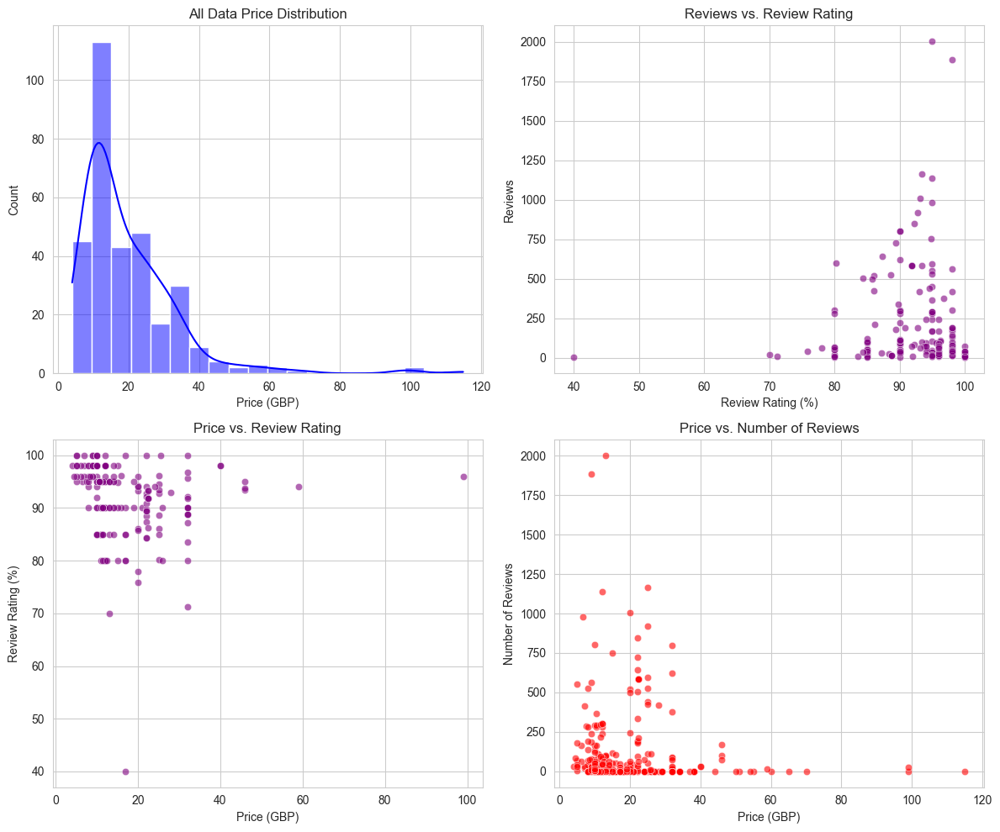

In [121]:
# set style
sns.set_style("whitegrid")

# create fig
fig, axes = plt.subplots(2, 2, figsize=(12, 10))

# 1. 價格直方圖
sns.histplot(all_data["prices"], bins=20, kde=True, ax=axes[0, 0], color="blue")
axes[0, 0].set_title("All Data Price Distribution")
axes[0, 0].set_xlabel("Price (GBP)")
axes[0, 0].set_ylabel("Count")

# 2. 評分直方圖
sns.scatterplot(x=all_data["reviews_rate"], y=all_data["reviews"], ax=axes[0, 1], alpha=0.6, color="purple")
axes[0, 1].set_title("Reviews vs. Review Rating")
axes[0, 1].set_xlabel("Review Rating (%)")
axes[0, 1].set_ylabel("Reviews")

# 3. 價格 vs. 評分 散點圖
sns.scatterplot(x=all_data["prices"], y=all_data["reviews_rate"], ax=axes[1, 0], alpha=0.6, color="purple")
axes[1, 0].set_title("Price vs. Review Rating")
axes[1, 0].set_xlabel("Price (GBP)")
axes[1, 0].set_ylabel("Review Rating (%)")

# 4. 價格 vs. 評論數量 散點圖
sns.scatterplot(x=all_data["prices"], y=all_data["reviews"], ax=axes[1, 1], alpha=0.6, color="red")
axes[1, 1].set_title("Price vs. Number of Reviews")
axes[1, 1].set_xlabel("Price (GBP)")
axes[1, 1].set_ylabel("Number of Reviews")

# 調整布局
plt.tight_layout()
plt.show()

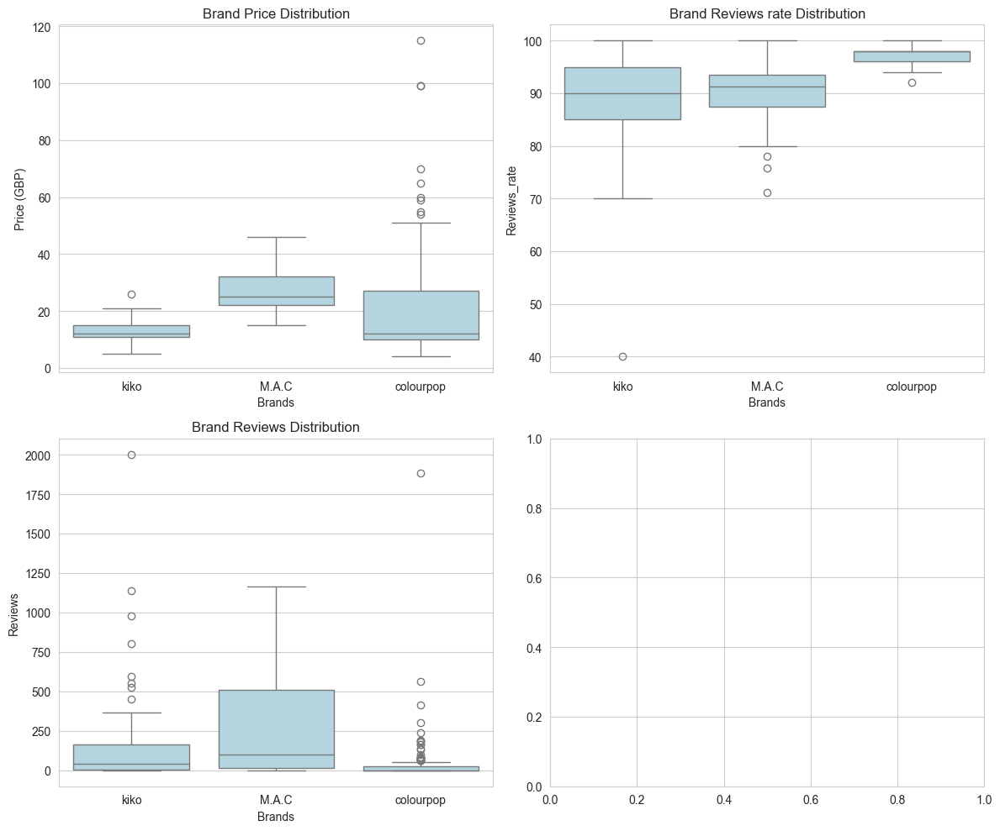

In [119]:
# set style
sns.set_style("whitegrid")

# create fig
fig, axes = plt.subplots(2, 2, figsize=(12, 10))

# 1. 
sns.boxplot(x="company", y="prices", data=all_data, ax=axes[0, 0], color="lightblue")
axes[0, 0].set_title("Brand Price Distribution")
axes[0, 0].set_xlabel("Brands")
axes[0, 0].set_ylabel("Price (GBP)")

# 2. 
sns.boxplot(x="company", y="reviews_rate", data=all_data, ax=axes[0, 1], color="lightblue")
axes[0, 1].set_title("Brand Reviews rate Distribution")
axes[0, 1].set_xlabel("Brands")
axes[0, 1].set_ylabel("Reviews_rate")

# 3. 
sns.boxplot(x="company", y="reviews", data=all_data, ax=axes[1, 0], color="lightblue")
axes[1, 0].set_title("Brand Reviews Distribution")
axes[1, 0].set_xlabel("Brands")
axes[1, 0].set_ylabel("Reviews")

# 調整布局
plt.tight_layout()
plt.show()

## 3.2 Lipsticks

#### statistic

In [128]:
lipsticks_df_merged.describe()

,prices,reviews,reviews_rate
count,174.000000,176.000000,61.000000
mean,19.441149,82.772727,90.698361
std,11.439259,245.110435,6.683873
min,5.000000,0.000000,70.000000
25%,10.000000,0.000000,88.600000
50%,16.000000,0.000000,90.000000
75%,27.000000,30.750000,96.000000
max,70.000000,2002.000000,100.000000


In [113]:
lipsticks_df_merged

,names,prices,reviews,reviews_rate,company
0,Bridgerton Ballroom Beauty Satin Shine Lipstick,20.99,41.0,90.0,kiko
1,Create Your Balance Soft Touch Lip&Cheek,12.99,20.0,70.0,kiko
2,Disney - The Little Mermaid Creamy Lip Stylo,16.99,28.0,90.0,kiko
3,Dreamphoria Shapechanger Satin Lipstick,15.99,0.0,NaN,kiko
4,Dreamphoria Tint Me Softly Lip Mousse,14.99,0.0,NaN,kiko
...,...,...,...,...,...
171,Winx Ultra Glossy Lip,8.00,0.0,NaN,colourpop
172,Magix Pout,54.00,0.0,NaN,colourpop
173,Evolution,27.00,0.0,NaN,colourpop
174,True Love's Kiss,50.00,0.0,NaN,colourpop


#### plot

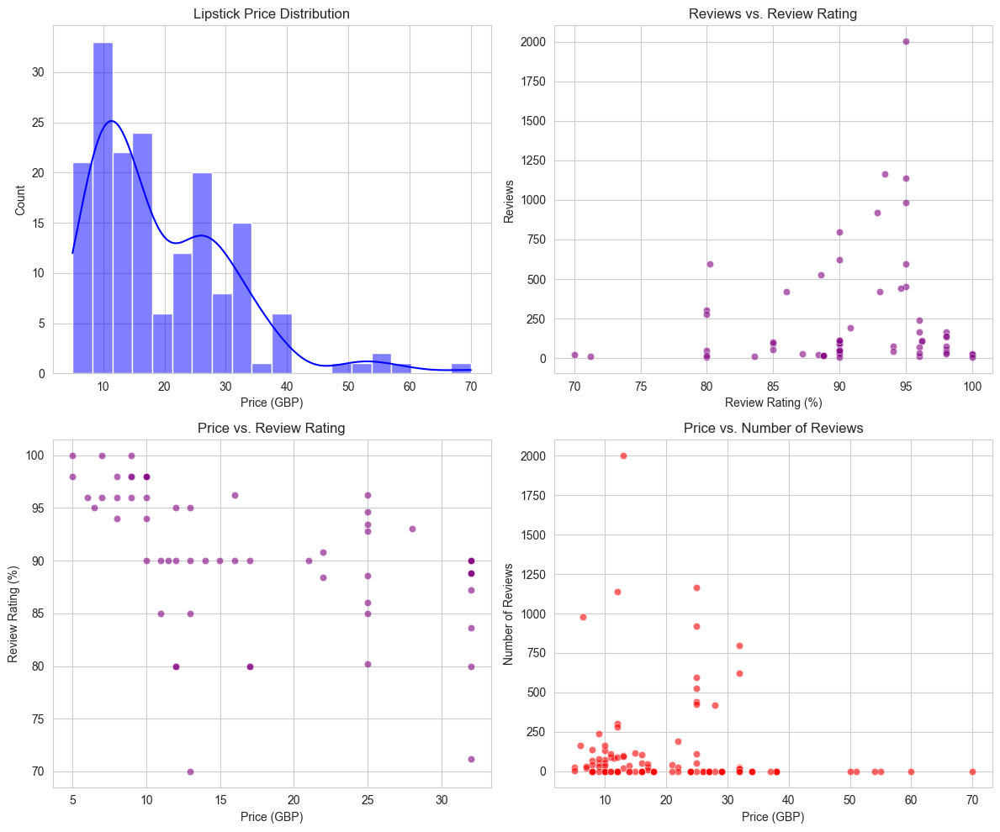

In [122]:
# set style
sns.set_style("whitegrid")

# create fig
fig, axes = plt.subplots(2, 2, figsize=(12, 10))

# 1. 價格直方圖
sns.histplot(lipsticks_df_merged["prices"], bins=20, kde=True, ax=axes[0, 0], color="blue")
axes[0, 0].set_title("Lipstick Price Distribution")
axes[0, 0].set_xlabel("Price (GBP)")
axes[0, 0].set_ylabel("Count")

# 2. 評分直方圖
sns.scatterplot(x=lipsticks_df_merged["reviews_rate"], y=lipsticks_df_merged["reviews"], ax=axes[0, 1], alpha=0.6, color="purple")
axes[0, 1].set_title("Reviews vs. Review Rating")
axes[0, 1].set_xlabel("Review Rating (%)")
axes[0, 1].set_ylabel("Reviews")

# 3. 價格 vs. 評分 散點圖
sns.scatterplot(x=lipsticks_df_merged["prices"], y=lipsticks_df_merged["reviews_rate"], ax=axes[1, 0], alpha=0.6, color="purple")
axes[1, 0].set_title("Price vs. Review Rating")
axes[1, 0].set_xlabel("Price (GBP)")
axes[1, 0].set_ylabel("Review Rating (%)")

# 4. 價格 vs. 評論數量 散點圖
sns.scatterplot(x=lipsticks_df_merged["prices"], y=lipsticks_df_merged["reviews"], ax=axes[1, 1], alpha=0.6, color="red")
axes[1, 1].set_title("Price vs. Number of Reviews")
axes[1, 1].set_xlabel("Price (GBP)")
axes[1, 1].set_ylabel("Number of Reviews")

# 調整布局
plt.tight_layout()
plt.show()


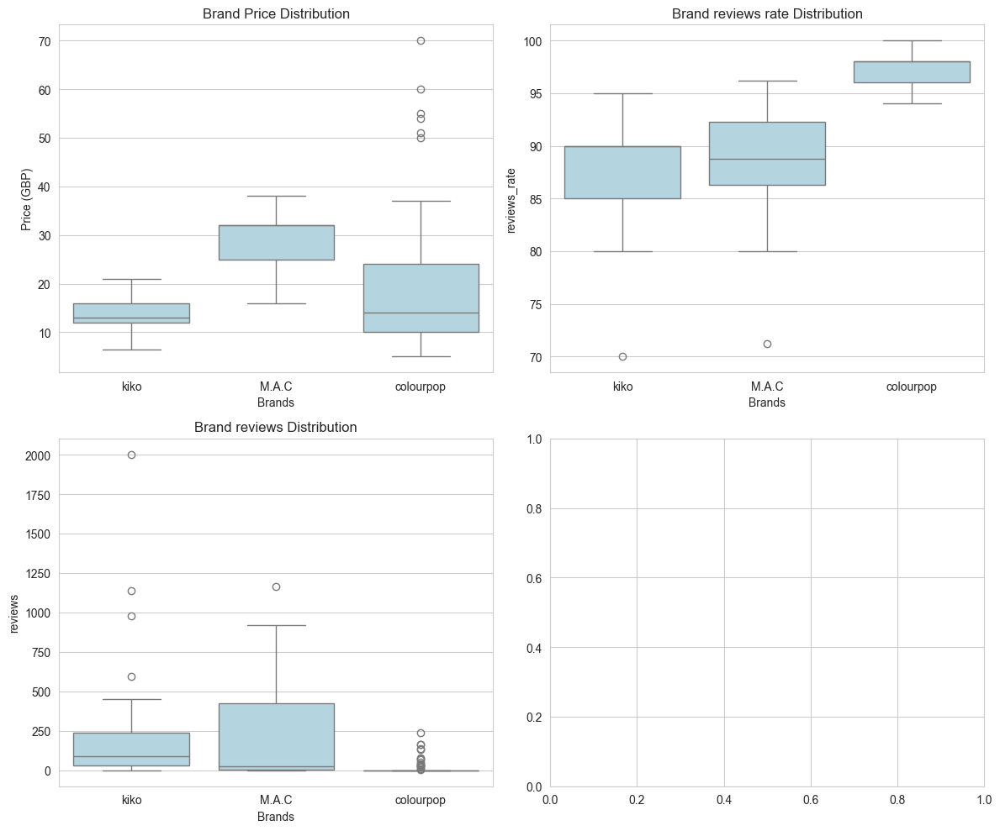

In [ ]:
# set style
sns.set_style("whitegrid")

# create fig
fig, axes = plt.subplots(2, 2, figsize=(12, 10))

# 1. 
sns.boxplot(x="company", y="prices", data=lipsticks_df_merged, ax=axes[0, 0], color="lightblue")
axes[0, 0].set_title("Brand Price Distribution")
axes[0, 0].set_xlabel("Brands")
axes[0, 0].set_ylabel("Price (GBP)")

# 2. 
sns.boxplot(x="company", y="reviews_rate", data=lipsticks_df_merged, ax=axes[0, 1], color="lightblue")
axes[0, 1].set_title("Brand reviews rate Distribution")
axes[0, 1].set_xlabel("Brands")
axes[0, 1].set_ylabel("reviews_rate")

# 3. 
sns.boxplot(x="company", y="reviews", data=lipsticks_df_merged, ax=axes[1, 0], color="lightblue")
axes[1, 0].set_title("Brand reviews Distribution")
axes[1, 0].set_xlabel("Brands")
axes[1, 0].set_ylabel("reviews")

# 調整布局
plt.tight_layout()
plt.show()

## 3.3 Eyeshadow

#### statistic

In [129]:
eyeshadow_df_merged.describe()

,prices,reviews,reviews_rate
count,65.000000,67.000000,52.000000
mean,22.450154,158.029851,93.346154
std,19.417007,305.467598,5.067097
min,4.990000,0.000000,80.000000
25%,10.990000,5.500000,90.000000
50%,15.000000,45.000000,95.000000
75%,32.000000,175.000000,97.100000
max,115.000000,1885.000000,100.000000


#### plot

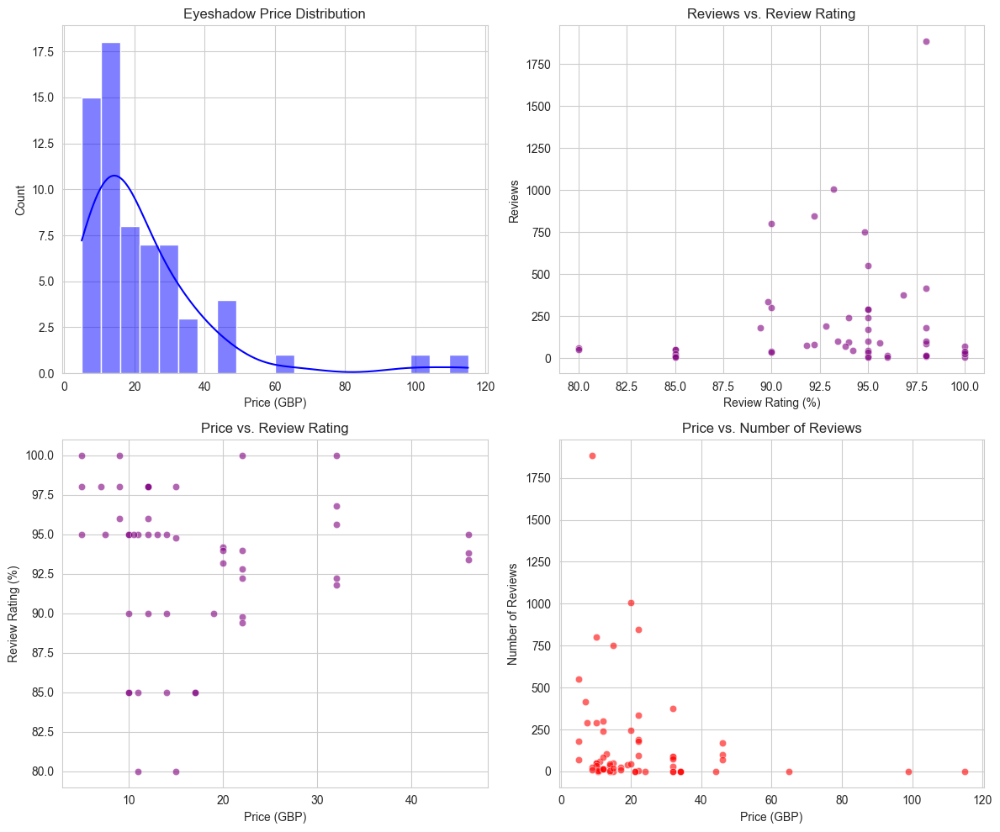

In [125]:
# set style
sns.set_style("whitegrid")

# create fig
fig, axes = plt.subplots(2, 2, figsize=(12, 10))

# 1. 價格直方圖
sns.histplot(eyeshadow_df_merged["prices"], bins=20, kde=True, ax=axes[0, 0], color="blue")
axes[0, 0].set_title("Eyeshadow Price Distribution")
axes[0, 0].set_xlabel("Price (GBP)")
axes[0, 0].set_ylabel("Count")

# 2. 評分直方圖
sns.scatterplot(x=eyeshadow_df_merged["reviews_rate"], y=eyeshadow_df_merged["reviews"], ax=axes[0, 1], alpha=0.6, color="purple")
axes[0, 1].set_title("Reviews vs. Review Rating")
axes[0, 1].set_xlabel("Review Rating (%)")
axes[0, 1].set_ylabel("Reviews")

# 3. 價格 vs. 評分 散點圖
sns.scatterplot(x=eyeshadow_df_merged["prices"], y=eyeshadow_df_merged["reviews_rate"], ax=axes[1, 0], alpha=0.6, color="purple")
axes[1, 0].set_title("Price vs. Review Rating")
axes[1, 0].set_xlabel("Price (GBP)")
axes[1, 0].set_ylabel("Review Rating (%)")

# 4. 價格 vs. 評論數量 散點圖
sns.scatterplot(x=eyeshadow_df_merged["prices"], y=eyeshadow_df_merged["reviews"], ax=axes[1, 1], alpha=0.6, color="red")
axes[1, 1].set_title("Price vs. Number of Reviews")
axes[1, 1].set_xlabel("Price (GBP)")
axes[1, 1].set_ylabel("Number of Reviews")

# 調整布局
plt.tight_layout()
plt.show()


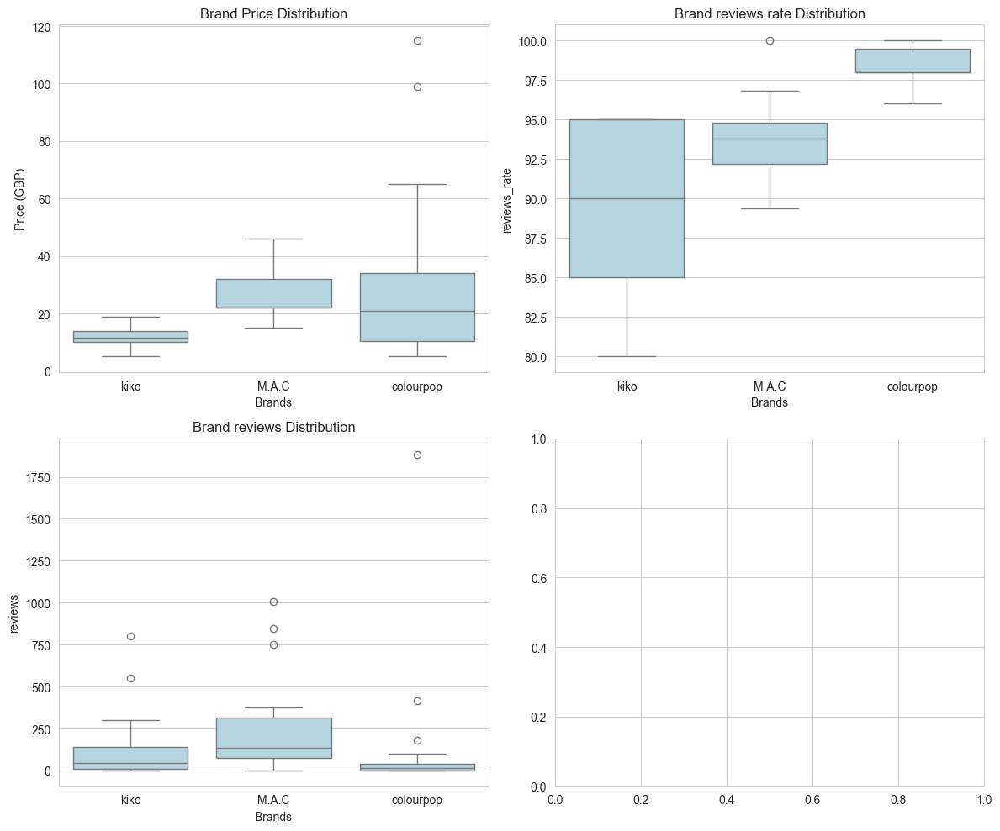

In [ ]:
# set style
sns.set_style("whitegrid")

# create fig
fig, axes = plt.subplots(2, 2, figsize=(12, 10))

# 1. 
sns.boxplot(x="company", y="prices", data=eyeshadow_df_merged, ax=axes[0, 0], color="lightblue")
axes[0, 0].set_title("Brand Price Distribution")
axes[0, 0].set_xlabel("Brands")
axes[0, 0].set_ylabel("Price (GBP)")

# 2. 
sns.boxplot(x="company", y="reviews_rate", data=eyeshadow_df_merged, ax=axes[0, 1], color="lightblue")
axes[0, 1].set_title("Brand reviews rate Distribution")
axes[0, 1].set_xlabel("Brands")
axes[0, 1].set_ylabel("reviews_rate")

# 3. 
sns.boxplot(x="company", y="reviews", data=eyeshadow_df_merged, ax=axes[1, 0], color="lightblue")
axes[1, 0].set_title("Brand reviews Distribution")
axes[1, 0].set_xlabel("Brands")
axes[1, 0].set_ylabel("reviews")

# 調整布局
plt.tight_layout()
plt.show()

## 3.4 Eyeliner

#### statistic

In [130]:
eyeliner_df_merged.describe()

,prices,reviews,reviews_rate
count,43.000000,44.000000,37.000000
mean,17.588372,147.181818,91.789189
std,16.304510,205.281007,6.293020
min,4.000000,0.000000,75.800000
25%,10.490000,17.250000,86.000000
50%,11.490000,39.000000,95.000000
75%,20.000000,188.500000,96.000000
max,99.000000,724.000000,98.000000


#### plot

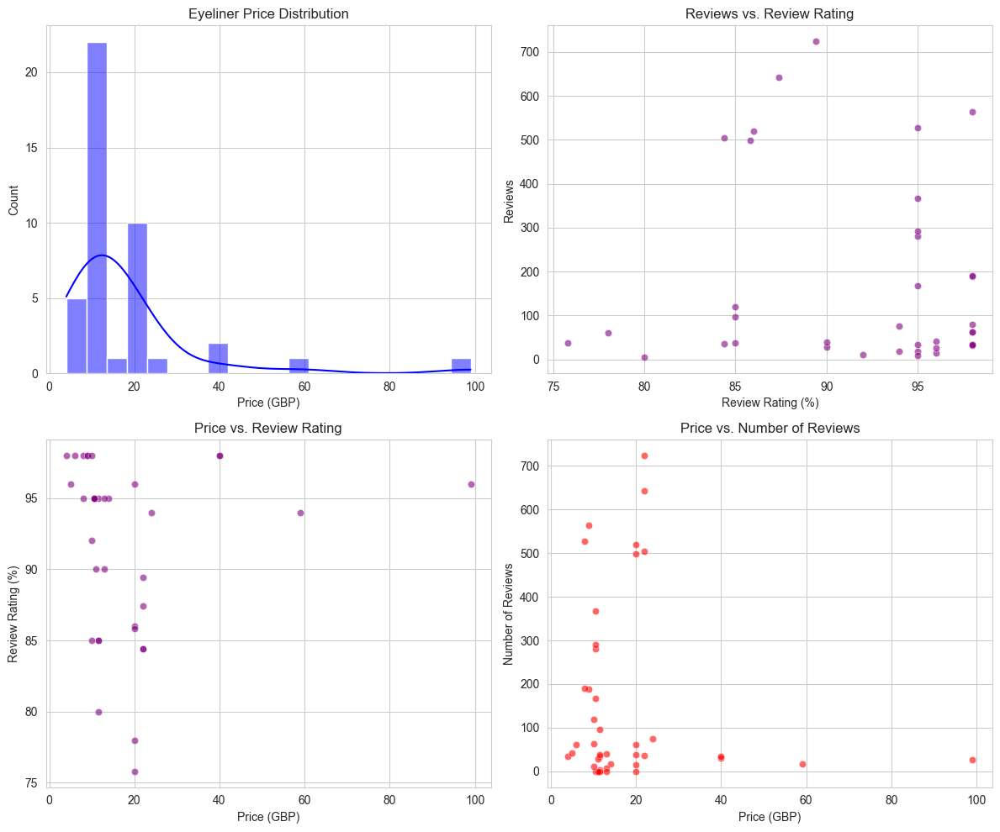

In [124]:
# set style
sns.set_style("whitegrid")

# create fig
fig, axes = plt.subplots(2, 2, figsize=(12, 10))

# 1. 價格直方圖
sns.histplot(eyeliner_df_merged["prices"], bins=20, kde=True, ax=axes[0, 0], color="blue")
axes[0, 0].set_title("Eyeliner Price Distribution")
axes[0, 0].set_xlabel("Price (GBP)")
axes[0, 0].set_ylabel("Count")

# 2. 評分直方圖
sns.scatterplot(x=eyeliner_df_merged["reviews_rate"], y=eyeliner_df_merged["reviews"], ax=axes[0, 1], alpha=0.6, color="purple")
axes[0, 1].set_title("Reviews vs. Review Rating")
axes[0, 1].set_xlabel("Review Rating (%)")
axes[0, 1].set_ylabel("Reviews")

# 3. 價格 vs. 評分 散點圖
sns.scatterplot(x=eyeliner_df_merged["prices"], y=eyeliner_df_merged["reviews_rate"], ax=axes[1, 0], alpha=0.6, color="purple")
axes[1, 0].set_title("Price vs. Review Rating")
axes[1, 0].set_xlabel("Price (GBP)")
axes[1, 0].set_ylabel("Review Rating (%)")

# 4. 價格 vs. 評論數量 散點圖
sns.scatterplot(x=eyeliner_df_merged["prices"], y=eyeliner_df_merged["reviews"], ax=axes[1, 1], alpha=0.6, color="red")
axes[1, 1].set_title("Price vs. Number of Reviews")
axes[1, 1].set_xlabel("Price (GBP)")
axes[1, 1].set_ylabel("Number of Reviews")

# 調整布局
plt.tight_layout()
plt.show()


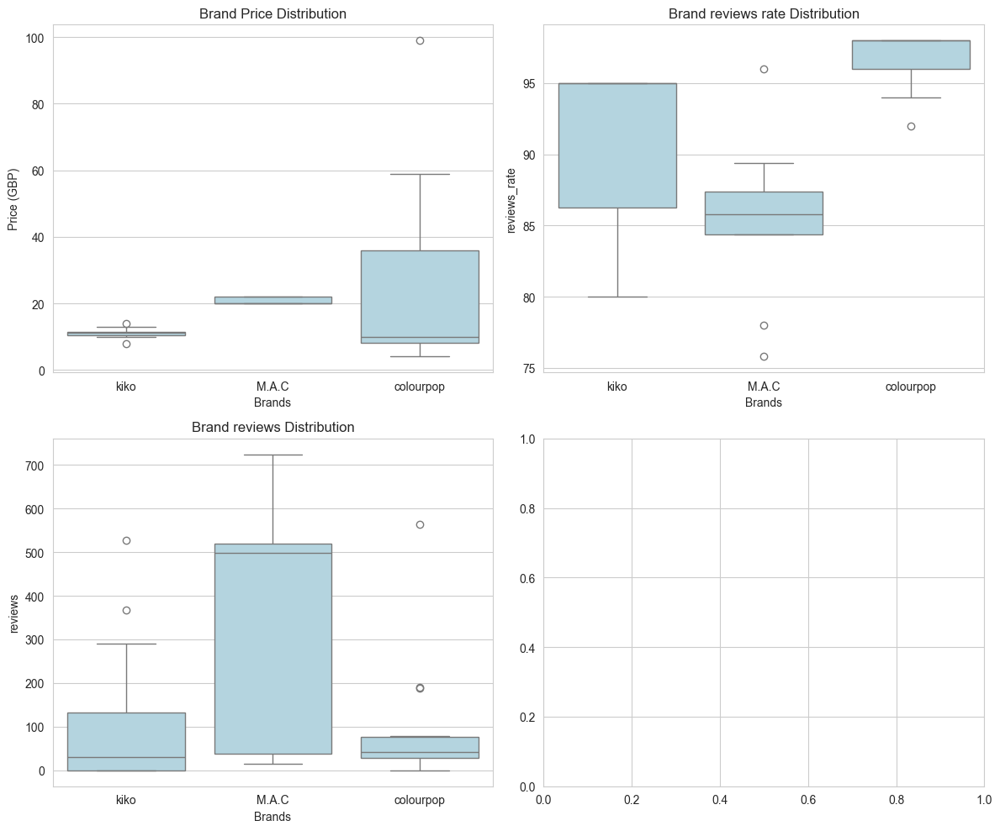

In [ ]:
# set style
sns.set_style("whitegrid")

# create fig
fig, axes = plt.subplots(2, 2, figsize=(12, 10))

# 1. 
sns.boxplot(x="company", y="prices", data=eyeliner_df_merged, ax=axes[0, 0], color="lightblue")
axes[0, 0].set_title("Brand Price Distribution")
axes[0, 0].set_xlabel("Brands")
axes[0, 0].set_ylabel("Price (GBP)")

# 2. 
sns.boxplot(x="company", y="reviews_rate", data=eyeliner_df_merged, ax=axes[0, 1], color="lightblue")
axes[0, 1].set_title("Brand reviews rate Distribution")
axes[0, 1].set_xlabel("Brands")
axes[0, 1].set_ylabel("reviews_rate")

# 3. 
sns.boxplot(x="company", y="reviews", data=eyeliner_df_merged, ax=axes[1, 0], color="lightblue")
axes[1, 0].set_title("Brand reviews Distribution")
axes[1, 0].set_xlabel("Brands")
axes[1, 0].set_ylabel("reviews")

# 調整布局
plt.tight_layout()
plt.show()

## 3.5 Blush

#### statistic

In [131]:
blush_df_merged.describe()

,prices,reviews,reviews_rate
count,38.000000,38.000000,30.000000
mean,17.560263,116.368421,92.573333
std,8.503136,183.648080,11.338519
min,4.500000,0.000000,40.000000
25%,10.372500,2.500000,90.450000
50%,15.990000,38.500000,96.000000
75%,22.400000,105.000000,98.000000
max,38.000000,584.000000,100.000000


#### plot

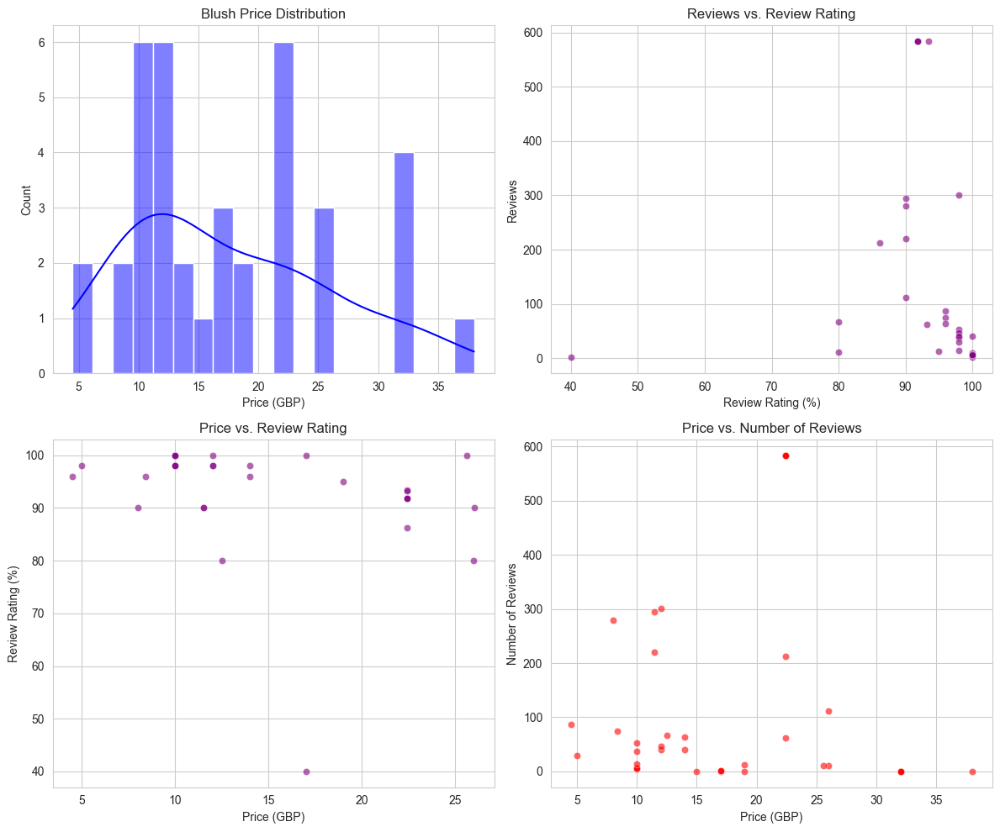

In [126]:
# set style
sns.set_style("whitegrid")

# create fig
fig, axes = plt.subplots(2, 2, figsize=(12, 10))

# 1. 價格直方圖
sns.histplot(blush_df_merged["prices"], bins=20, kde=True, ax=axes[0, 0], color="blue")
axes[0, 0].set_title("Blush Price Distribution")
axes[0, 0].set_xlabel("Price (GBP)")
axes[0, 0].set_ylabel("Count")

# 2. 評分直方圖
sns.scatterplot(x=blush_df_merged["reviews_rate"], y=blush_df_merged["reviews"], ax=axes[0, 1], alpha=0.6, color="purple")
axes[0, 1].set_title("Reviews vs. Review Rating")
axes[0, 1].set_xlabel("Review Rating (%)")
axes[0, 1].set_ylabel("Reviews")

# 3. 價格 vs. 評分 散點圖
sns.scatterplot(x=blush_df_merged["prices"], y=blush_df_merged["reviews_rate"], ax=axes[1, 0], alpha=0.6, color="purple")
axes[1, 0].set_title("Price vs. Review Rating")
axes[1, 0].set_xlabel("Price (GBP)")
axes[1, 0].set_ylabel("Review Rating (%)")

# 4. 價格 vs. 評論數量 散點圖
sns.scatterplot(x=blush_df_merged["prices"], y=blush_df_merged["reviews"], ax=axes[1, 1], alpha=0.6, color="red")
axes[1, 1].set_title("Price vs. Number of Reviews")
axes[1, 1].set_xlabel("Price (GBP)")
axes[1, 1].set_ylabel("Number of Reviews")

# 調整布局
plt.tight_layout()
plt.show()


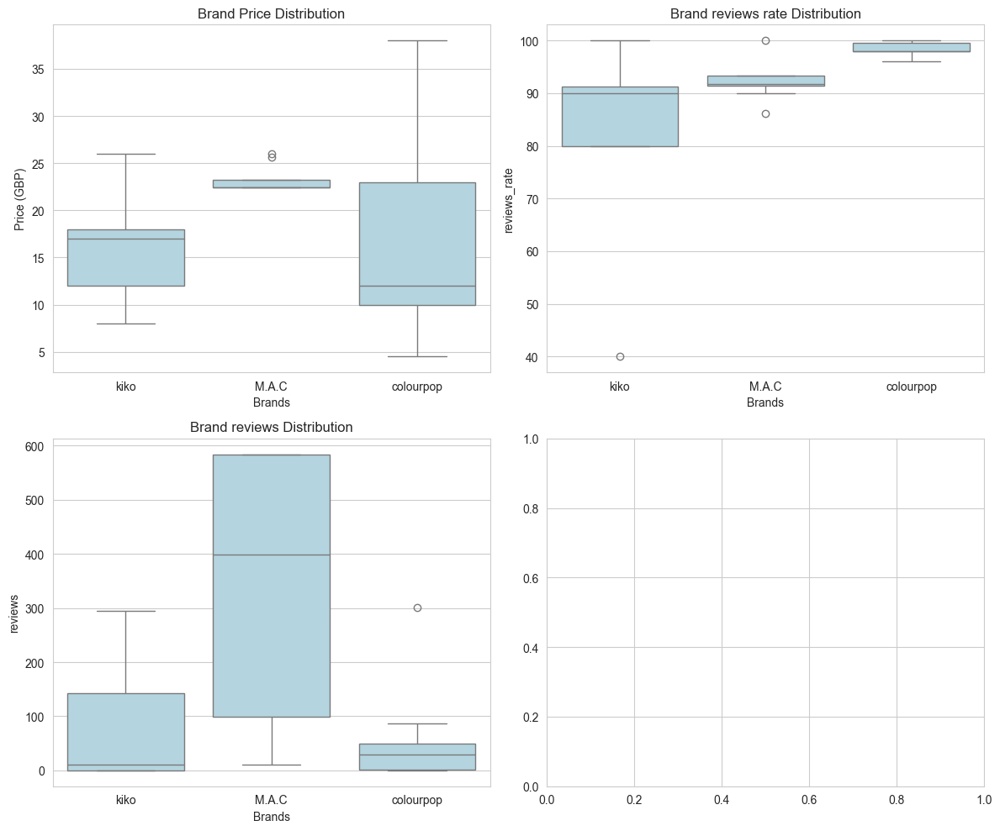

In [ ]:
# set style
sns.set_style("whitegrid")

# create fig
fig, axes = plt.subplots(2, 2, figsize=(12, 10))

# 1. 
sns.boxplot(x="company", y="prices", data=blush_df_merged, ax=axes[0, 0], color="lightblue")
axes[0, 0].set_title("Brand Price Distribution")
axes[0, 0].set_xlabel("Brands")
axes[0, 0].set_ylabel("Price (GBP)")

# 2. 
sns.boxplot(x="company", y="reviews_rate", data=blush_df_merged, ax=axes[0, 1], color="lightblue")
axes[0, 1].set_title("Brand reviews rate Distribution")
axes[0, 1].set_xlabel("Brands")
axes[0, 1].set_ylabel("reviews_rate")

# 3. 
sns.boxplot(x="company", y="reviews", data=blush_df_merged, ax=axes[1, 0], color="lightblue")
axes[1, 0].set_title("Brand reviews Distribution")
axes[1, 0].set_xlabel("Brands")
axes[1, 0].set_ylabel("reviews")

# 調整布局
plt.tight_layout()
plt.show()